In [21]:
import itertools

import matplotlib.pyplot as plt
import numpy as np

from stats import *
from utils import *
import visual as vi
from Inlier_Thresholder import Inlier_Thresholder
import scipy.io as spi
from time import time
import os
import seaborn as sns
from itertools import chain

## Fundamental Matrix Analysis

In [22]:
rootFM = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelFM/'
print(os.listdir(rootFM))
data = [f for f in os.listdir(rootFM) if os.path.isfile(rootFM + f)]
data1 = spi.loadmat(rootFM + data[13])
data2 = spi.loadmat(rootFM + data[3])
keypts = data1['data']

['cubebreadtoychips.mat', 'dinobooks.mat', 'biscuit.mat', 'game.mat', 'cube.mat', 'book.mat', 'breadtoycar.mat', 'gamebiscuit.mat', 'toycubecar.mat', 'biscuitbookbox.mat', 'breadcubechips.mat', 'breadcartoychips.mat', 'biscuitbook.mat', 'boardgame.mat', 'cubechips.mat', 'carchipscube.mat', 'cubetoy.mat', 'breadcube.mat', 'breadtoy.mat']


In [23]:
img1,img2=data1["img1"],data1["img2"]

outliers,models=vi.group_models(data1)["outliers"],vi.group_models(data1)["models"]

src_points = np.array(list(zip(models[0][0], models[0][1])))

dst_points = np.array(list(zip(models[0][2], models[0][3])))

In [24]:
t=time()
cv2_FM, cv2_mask = verify_LMEDS_FM(src_points, dst_points)
print (time()-t, ' sec cv2')

# t=time()
# gc_H, gc_mask = verify_pygcransac_H(src_points , dst_points , img1 , img2 , 2 , 10 , 20)
# print ((time()-t), ' sec gc-ransac')
#
#
#
# # Compute the element-wise difference
# difference_mask = gc_mask != cv2_mask
# difference_mask=difference_mask.astype(np.uint8)
# print("the difference between ransac and gc_ransac: ",len(difference_mask))

print("the total number of point is: ",len(src_points))

57.0 inliers found
0.0049741268157958984  sec cv2
the total number of point is:  69


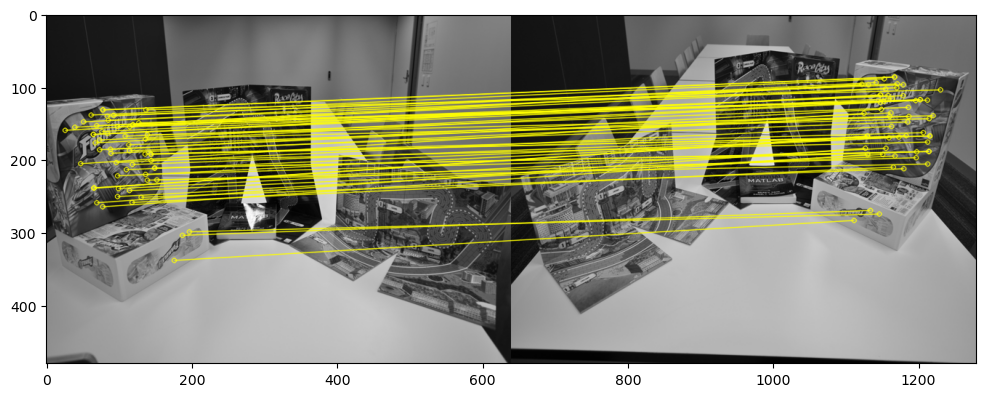

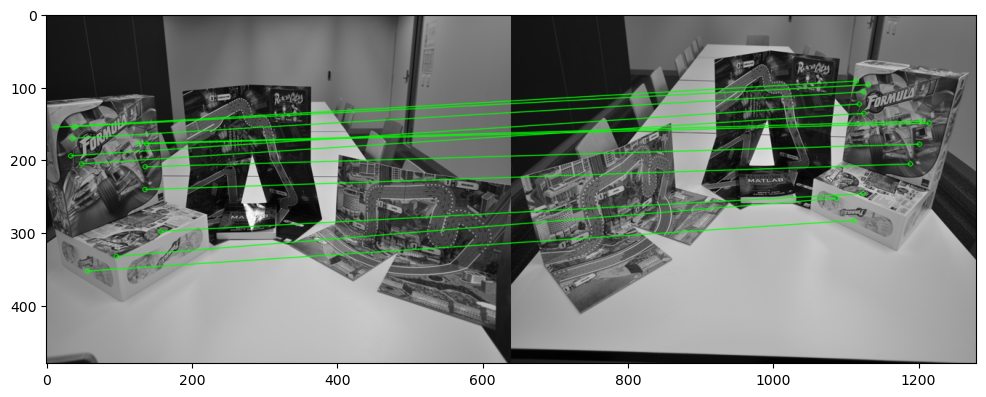

In [25]:
#draw_matches(img1,img2,src_points,dst_points,mask=gc_mask)
draw_matches(img1,img2,src_points,dst_points,mask=cv2_mask)
#draw_matches(img1,img2,src_points,dst_points, matchColor=(255,0,0) , mask=difference_mask)
draw_matches(img1,img2,src_points,dst_points, matchColor=(0,255,0) , mask=1-cv2_mask)

In [26]:
def drawlines(img1,img2,lines,pts1,pts2):
     ''' img1 - image on which we draw the epilines for the points in img2
     lines - corresponding epilines '''
     print(img1.shape)
     r,c = img1.shape[0], img1.shape[1]
     img1 = cv2.cvtColor(img1,cv2.COLOR_RGB2BGR)
     img2 = cv2.cvtColor(img2,cv2.COLOR_RGB2BGR)
     for r,pt1,pt2 in zip(lines,pts1,pts2):
         color = tuple(np.random.randint(0,255,3).tolist())
         x0,y0 = map(int, [0, -r[2]/r[1] ])
         x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
         img1 = cv2.line(img1, (x0,y0), (x1,y1), color,1)
         img1 = cv2.circle(img1,tuple(np.array(pt1).astype(int)),5,color,-1)
         img2 = cv2.circle(img2,tuple(np.array(pt2).astype(int)),5,color,-1)
     return img1,img2


(480, 640)
(480, 640)


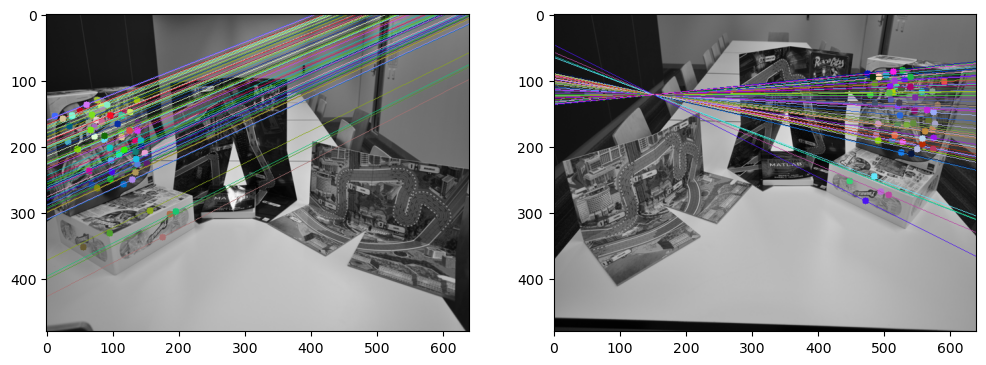

In [27]:
# Find epilines corresponding to points in right image (second image) and
# drawing its lines on left image
lines1 = cv2.computeCorrespondEpilines(dst_points.reshape(-1,1,2), 2,cv2_FM)
lines1 = lines1.reshape(-1,3)
img5,img6 = drawlines(img1,img2,lines1,src_points,dst_points)
# Find epilines corresponding to points in left image (first image) and
# drawing its lines on right image
lines2 = cv2.computeCorrespondEpilines(src_points.reshape(-1,1,2), 1,cv2_FM)
lines2 = lines2.reshape(-1,3)
img3,img4 = drawlines(img2,img1,lines2,dst_points,src_points)
plt.figure(figsize=(12,8))
plt.subplot(121),plt.imshow(img5)
plt.subplot(122),plt.imshow(img3)
plt.show()

In [28]:
compute_residuals_FM(src_points, dst_points, cv2_FM, method='sed')

array([6.70016828e-01, 3.83983866e-02, 7.73387206e-02, 5.12751007e-14,
       6.80618030e-02, 4.33775932e-01, 8.76643483e-02, 8.76643483e-02,
       1.10108514e-01, 9.01055825e-02, 2.82256288e-01, 5.84199357e-01,
       1.42448260e-01, 4.87319532e-14, 4.87319532e-14, 3.70062105e-01,
       4.06335014e-01, 7.40694749e-01, 7.40694749e-01, 3.37288079e-14,
       2.37645341e+01, 1.07976189e-01, 6.51450071e-01, 1.25969726e-01,
       2.13298757e-01, 2.60929302e-01, 2.70419350e-01, 9.33254421e-02,
       1.20183683e+00, 9.38986850e-02, 9.38986850e-02, 3.33653917e-01,
       1.33431141e-13, 9.26990909e-01, 5.87947647e-01, 1.14965019e+00,
       1.73467118e-01, 5.34224603e+01, 2.16977960e-02, 2.16977960e-02,
       4.21870998e-01, 1.07998801e-01, 1.52593637e-01, 1.51833046e-01,
       2.25570603e-01, 6.72887419e-01, 9.96039652e-14, 5.92476450e-01,
       1.68883632e+00, 8.48611268e-01, 1.48185030e+00, 3.18924987e-01,
       6.17048531e-01, 6.17048531e-01, 1.22846688e-01, 6.73428662e-01,
      

In [29]:
compute_residuals_FM(src_points, dst_points, cv2_FM, method='sampson')

array([1.08686724e-01, 3.64947035e-04, 1.48143281e-03, 7.06182850e-29,
       1.15785544e-03, 4.69492785e-02, 1.92092914e-03, 1.92092914e-03,
       3.01828647e-03, 2.01726533e-03, 1.97999113e-02, 8.51763375e-02,
       5.04364182e-03, 5.59163453e-28, 5.59163453e-28, 3.39811124e-02,
       4.06392346e-02, 1.35178985e-01, 1.35178985e-01, 2.81908222e-28,
       1.30151100e+02, 2.89615554e-03, 1.05313077e-01, 3.96112783e-03,
       1.13717450e-02, 1.70208214e-02, 1.82288346e-02, 2.17383614e-03,
       3.59424294e-01, 2.19002009e-03, 2.19002009e-03, 2.74930917e-02,
       1.10711128e-27, 2.01972009e-01, 8.19376739e-02, 3.15707901e-01,
       7.23610238e-03, 6.80916784e+02, 1.14747637e-04, 1.14747637e-04,
       4.31200030e-02, 2.86065340e-03, 5.76135977e-03, 5.73251904e-03,
       1.26453880e-02, 1.12950600e-01, 2.53849139e-28, 8.77562962e-02,
       6.52479443e-01, 1.69827945e-01, 5.20430258e-01, 2.42896283e-02,
       9.22472990e-02, 9.22472990e-02, 3.70376242e-03, 1.10355855e-01,
      

In [30]:
point_belongs_to_model(models, type='FM', threshold=1, method='sampson')

61.0 inliers found
59.0 inliers found
18.0 inliers found


{'model1_point2': [],
 'model1_point3': [44, 64],
 'model2_point1': [],
 'model2_point3': [],
 'model3_point1': [7],
 'model3_point2': []}

61.0 inliers found
59.0 inliers found
18.0 inliers found
No ambiguous points found for model 1
18.0 inliers found
61.0 inliers found
(480, 640)
(480, 640)


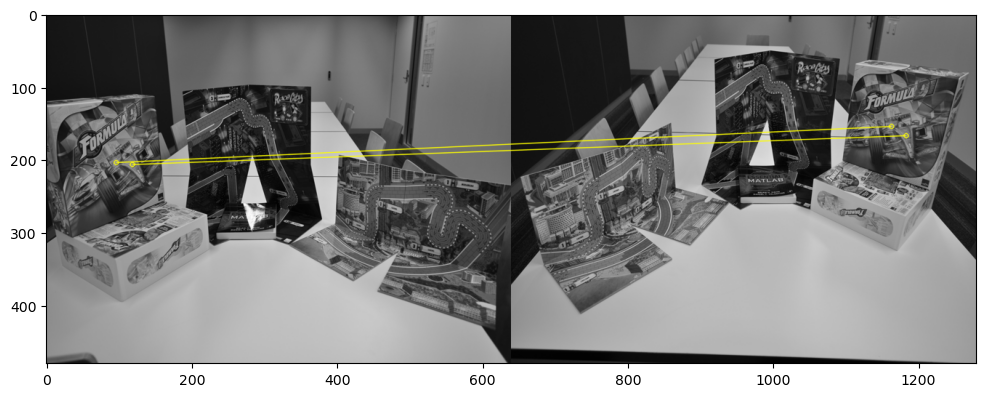

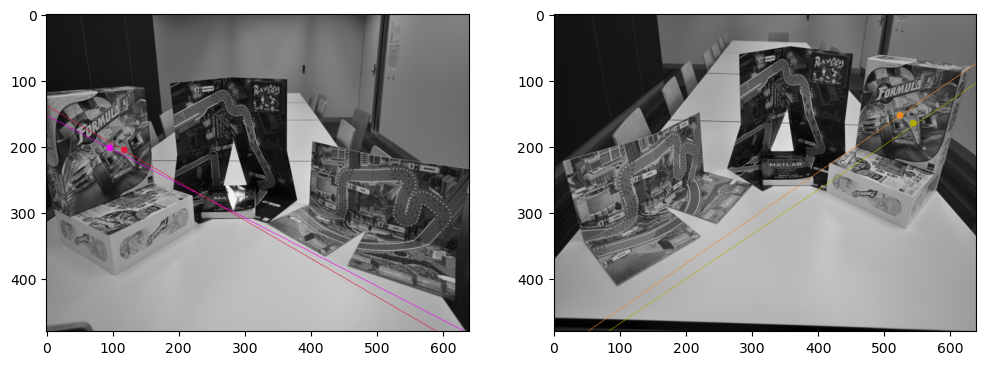

No ambiguous points found for model 0
No ambiguous points found for model 2
61.0 inliers found
18.0 inliers found
(480, 640)
(480, 640)


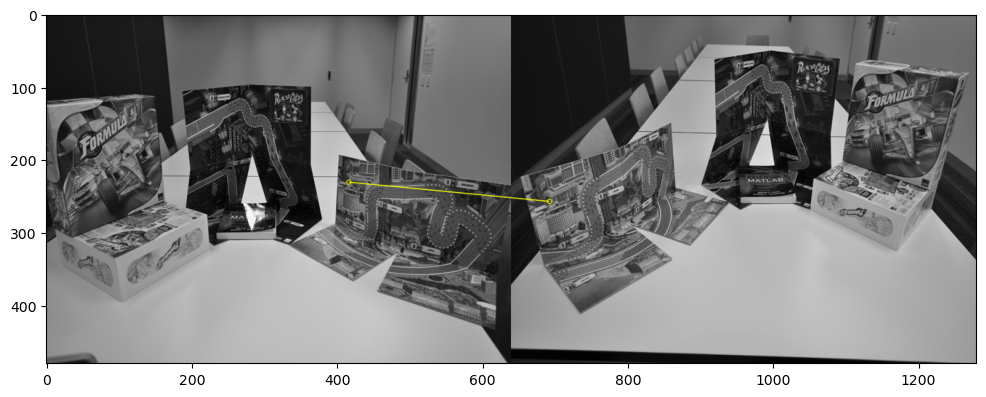

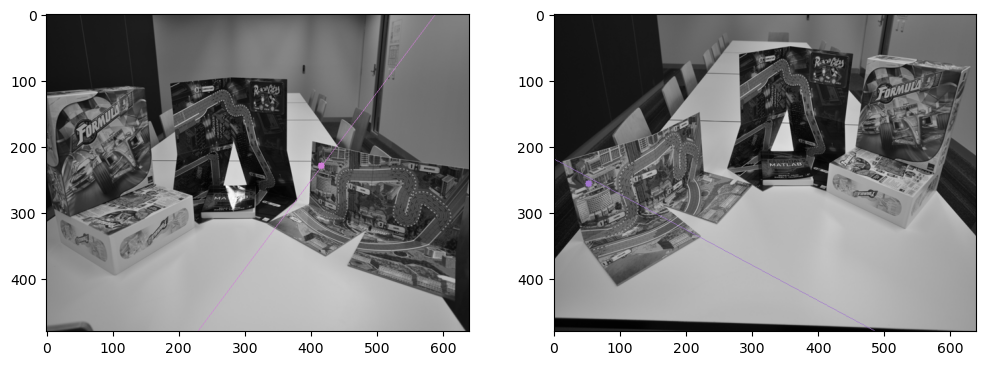

No ambiguous points found for model 1


In [31]:
correspondences = point_belongs_to_model(models, type='FM', threshold=1, method='sampson')
for corr in correspondences:
    m_idx = int(corr[-1])-1
    p_idx = int(corr[5])-1
    ambiguous_model_points = correspondences.get(corr)
    if len(ambiguous_model_points) > 0:

        src_points0 = np.array(list(zip(models[m_idx][0], models[m_idx][1])))
        dst_points0 = np.array(list(zip(models[m_idx][2], models[m_idx][3])))
        src_points = np.array(list(zip(models[p_idx][0], models[p_idx][1])))
        dst_points = np.array(list(zip(models[p_idx][2], models[p_idx][3])))

        FM0,mask0 = verify_cv2_FM(src_points0, dst_points0)
        FM,mask = verify_cv2_FM(src_points, dst_points)

        draw_matches(img1, img2, src_points[ambiguous_model_points], dst_points[ambiguous_model_points])
        
        cv2_dst_lines = cv2.computeCorrespondEpilines(src_points.reshape(-1,1,2), 1,FM0)
        cv2_src_lines = cv2.computeCorrespondEpilines(dst_points.reshape(-1,1,2), 2,FM0)
        cv2_src_lines = cv2_src_lines.reshape(-1,3)
        img5,img6 = drawlines(img1,img2,cv2_src_lines[ambiguous_model_points],src_points[ambiguous_model_points],dst_points[ambiguous_model_points])
        cv2_dst_lines = cv2_dst_lines.reshape(-1,3)
        img3,img4 = drawlines(img2,img1,cv2_dst_lines[ambiguous_model_points],dst_points[ambiguous_model_points],src_points[ambiguous_model_points])

        plt.figure(figsize=(12,8))
        plt.subplot(121),plt.imshow(img5)
        plt.grid(False)
        plt.subplot(122),plt.imshow(img3)
        plt.grid(False)
        plt.show()
        #draw_matches(img1, img2, src_points[ambiguous_model_points], cv2_dst_lines[ambiguous_model_points])
        #draw_matches(img1, img2, src_points, cv2_dst_lines)
    else:
        print("No ambiguous points found for model", m_idx)

## Analysis of residuals

In [32]:
directory = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelFM'

# List all files in the directory
files = os.listdir(directory)

# Filter out only the .mat files
mat_files = [file for file in files if file.endswith('.mat')]

# Load each .mat file
mat_data = {}
names=[]
for file in mat_files:
    file_path = os.path.join(directory, file)
    names.append(file)
    mat_data[file] = spi.loadmat(file_path)

In [33]:
number_of_data_to_analyse=len(names)
silhouette_scores = [[] for i in range(number_of_data_to_analyse)]
silhouette_avgs = [[] for i in range(number_of_data_to_analyse)]
labels_array = [[] for i in range(number_of_data_to_analyse)]
residuals = []
values_array = [[] for i in range(number_of_data_to_analyse)]
thresholds = [[] for i in range(number_of_data_to_analyse)]

for i in range(number_of_data_to_analyse):
    data=mat_data[names[i]]
    res, n_inl, n_outl=compute_inliers_residual_curve(data, type='FM')
    residuals.append(res)

    for j in range(len(res)):
        anomaly_detector=Inlier_Thresholder(res[j], n_inl[j], n_outl[j])
        #labels=anomaly_detector.compute_inlier_threshold("Rosseeuw QN")
        plt.figure()
        labels, threshold=anomaly_detector.use_best_method(verbose=True)
        #plot_res_curve(res[j],labels,"figure: "+str(i+1)+" Model: "+str(j+1))
        if len(np.unique(labels))!=1:
            if threshold is not None: thresholds[i].append(threshold)
            else: thresholds[i].append(0.95)
            labels_array[i].append(labels)
            silhouette_scr, silhouette_avg, values = silhouette_score_and_average(res[j], labels)
            silhouette_scores[i].append(silhouette_scr)
            silhouette_avgs[i].append(silhouette_avg)
            values_array[i].append(values)

Forward Search
Variance based
Forward Search
Forward Search
Variance based
Variance based
Variance based
Variance based
Variance based
Forward Search
Forward Search
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Median AD
Variance based


/var/folders/8y/rj__37254bl5rqq1swpv9p2m0000gn/T/ipykernel_37995/3053696296.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


Variance based
Variance based
Variance based
Variance based
IQR
IQR
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Variance based
Forward Search
Variance based
Variance based
Variance based
Variance based
Variance based


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

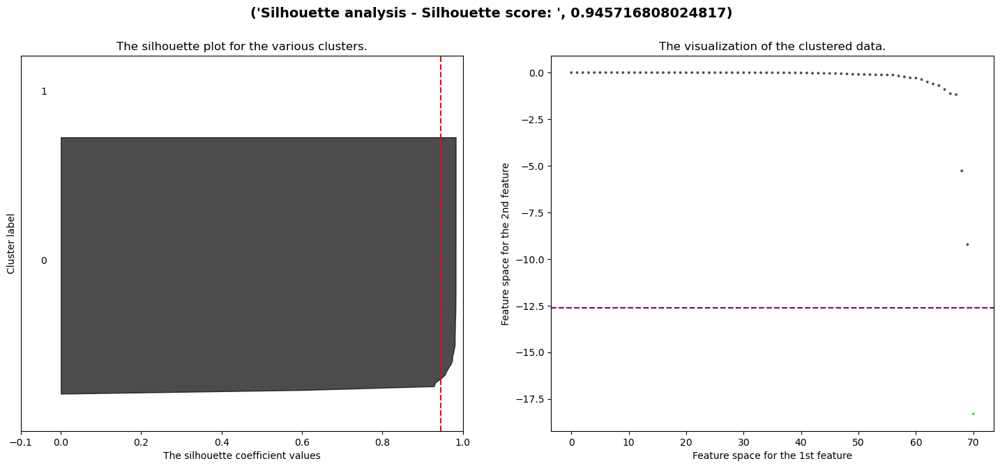

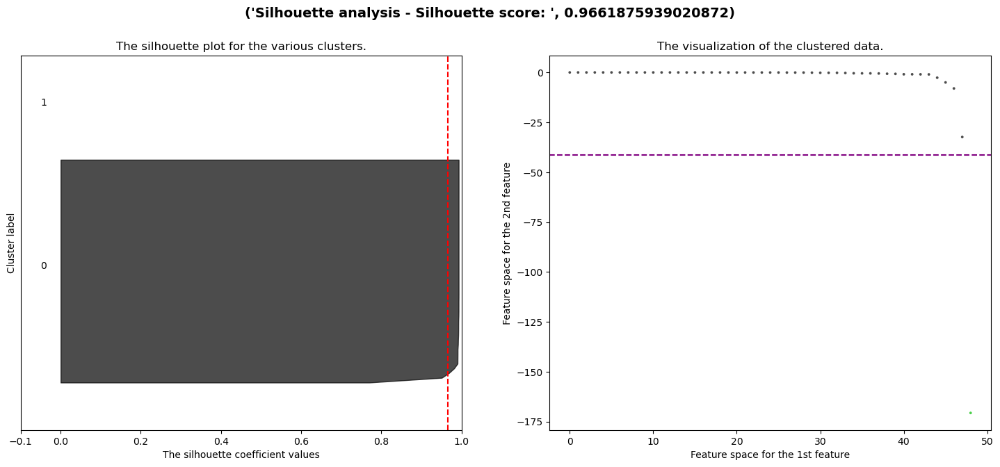

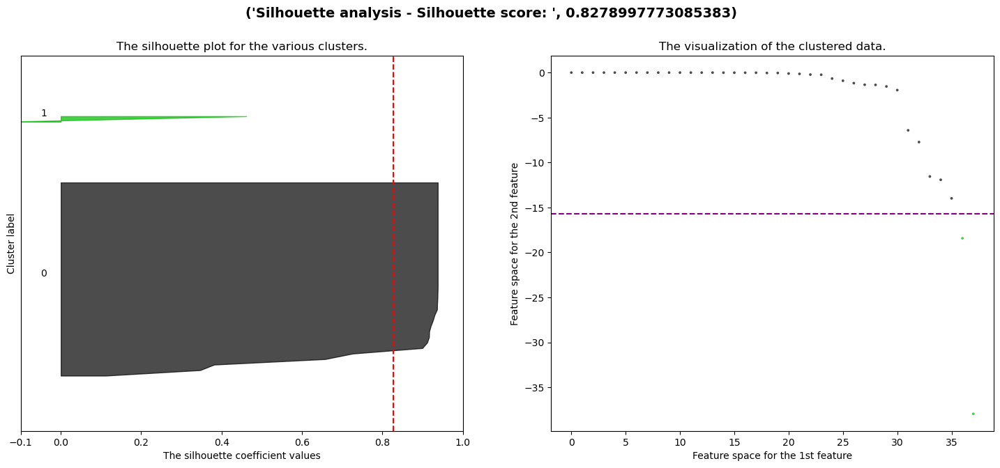

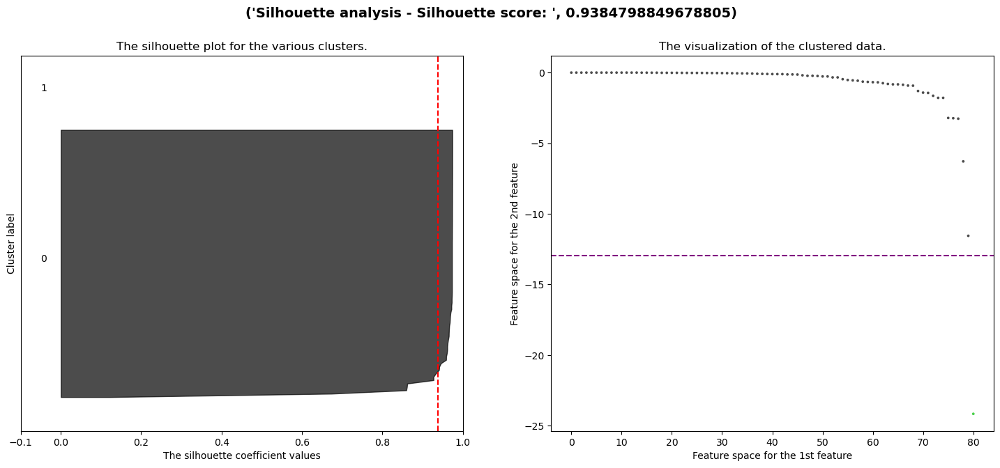

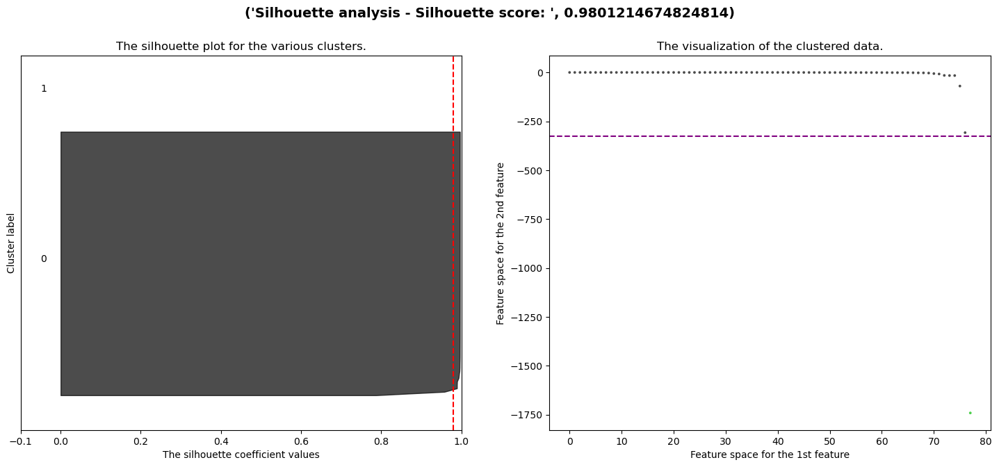

...

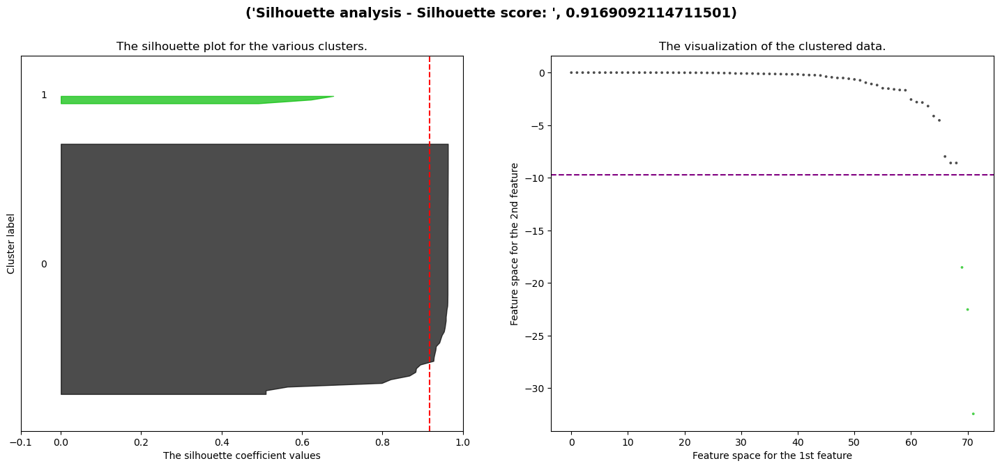

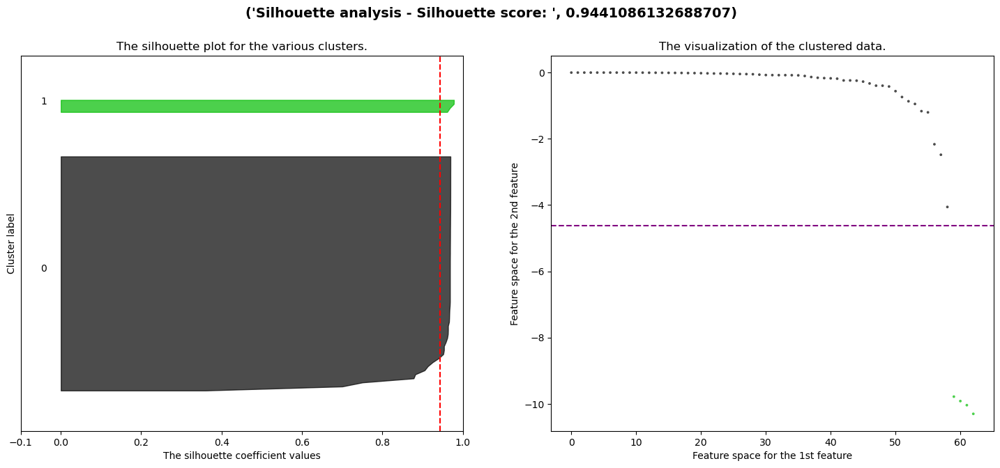

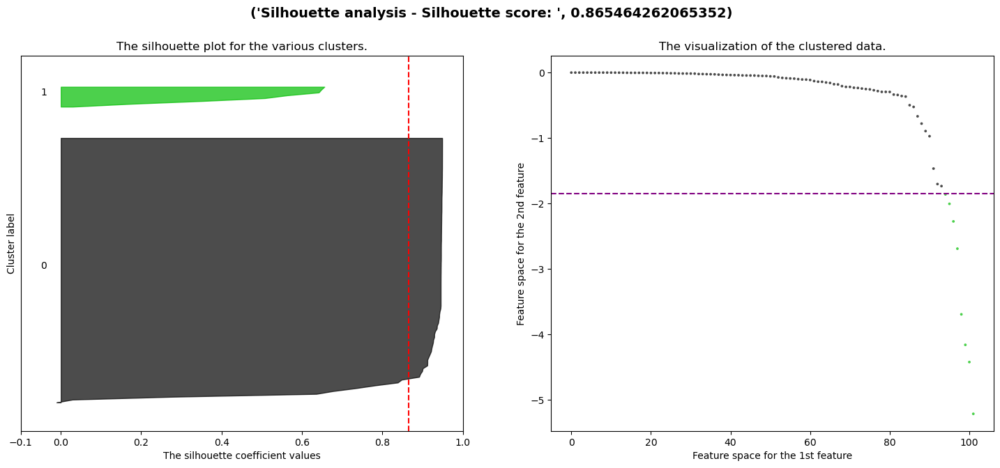

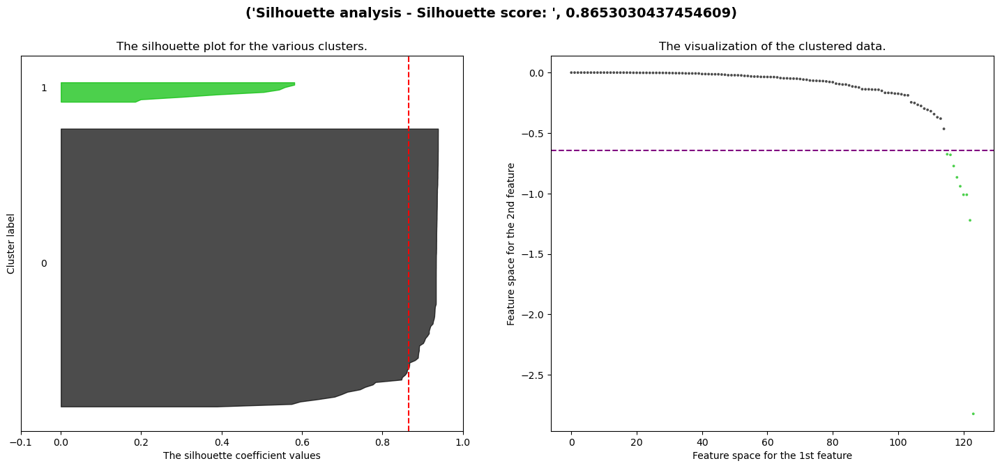

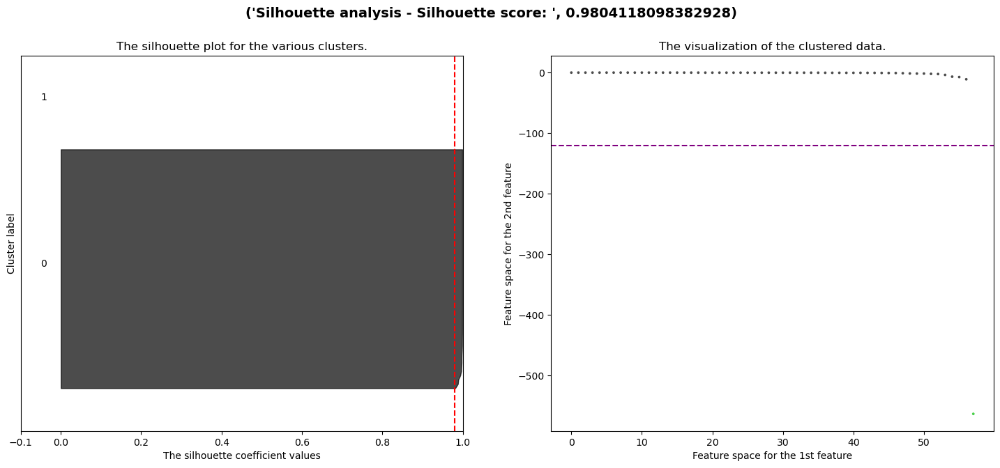

In [34]:
for i in range(len(silhouette_scores)):
    for j in range(len(silhouette_scores[i])):
        plot_silhouette(silhouette_scores[i][j], labels_array[i][j], silhouette_avgs[i][j], values_array[i][j], -thresholds[i][j])

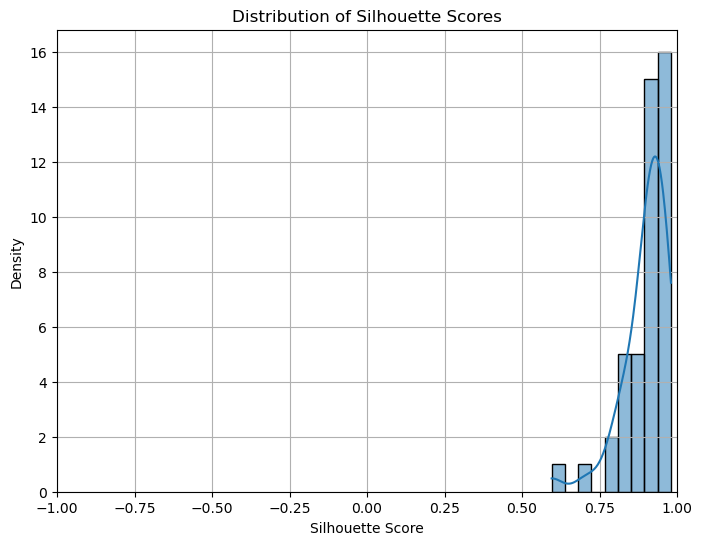

In [35]:
# Create a histogram to visualize the distribution
plt.figure(figsize=(8, 6))
sns.histplot(list(chain.from_iterable(silhouette_avgs)), bins='auto', kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Silhouette Score")
plt.ylabel("Density")
plt.title("Distribution of Silhouette Scores")

plt.grid(True)
plt.xlim(-1, 1)  # Set limits for silhouette scores (typically between -1 and 1)

# Display the plot
plt.show()

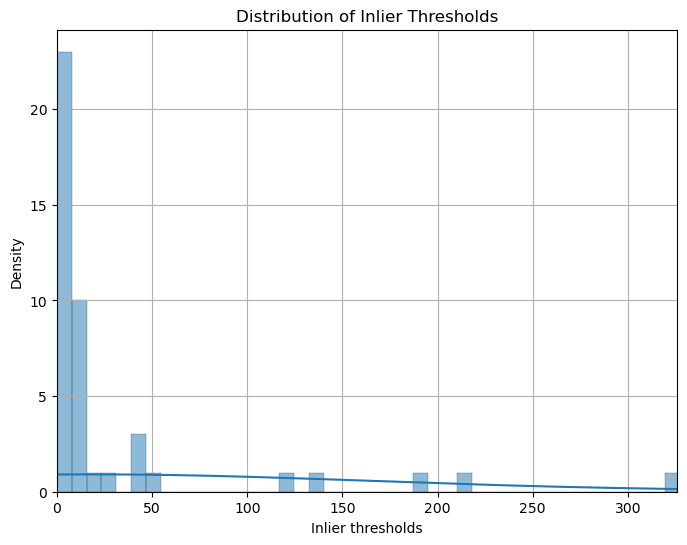

In [36]:
# Create a histogram to visualize the distribution
plt.figure(figsize=(8, 6))
sns.histplot(list(chain.from_iterable(thresholds)), bins='auto', kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Inlier thresholds")
plt.ylabel("Density")
plt.title("Distribution of Inlier Thresholds")

plt.grid(True)
plt.xlim(0, max(max(thresholds)))  # Set limits for silhouette scores (typically between -1 and 1)

# Display the plot
plt.show()

In [37]:
errors = []
average_error = {}

for i in range(len(names)):
    data = mat_data[names[i]]
    threshold = thresholds[i]
    average_errors = analyze_reprojection_error(data, threshold, type='FM')
    tmp_vals = average_errors.values()
    min_val = min(tmp_vals)
    idx = 0
    for h in range(len(tmp_vals)):
        if list(tmp_vals)[h] == min_val: idx = h
    min_t = list(average_errors.keys())[idx]
    print("Average reprojection errors for inliers:")
    average_error[min_t] = average_errors.get(min_t)
    for threshold, error in average_errors.items():
        print(f"Threshold: {threshold}, Average Reprojection Error: {error:.4f}")
          #errors.append(error)
    errors.append(average_error[min_t])

53.0 inliers found
38.0 inliers found
25.0 inliers found
73.0 inliers found
Average reprojection errors for inliers:
Threshold: 12.632078083660383, Average Reprojection Error: 0.0167
Threshold: 41.27489594490595, Average Reprojection Error: 0.0861
Threshold: 15.731348292509365, Average Reprojection Error: 0.0605
Threshold: 12.965899392272817, Average Reprojection Error: 0.2778
66.0 inliers found
70.0 inliers found
34.0 inliers found
Average reprojection errors for inliers:
Threshold: 325.8329070751438, Average Reprojection Error: 0.2188
Threshold: 9.070957638078777, Average Reprojection Error: 0.0515
Threshold: 47.79950417383173, Average Reprojection Error: 0.1308
135.0 inliers found
Average reprojection errors for inliers:
Threshold: 2.0854626006192545, Average Reprojection Error: 0.3149
58.0 inliers found
Average reprojection errors for inliers:
Threshold: 1.247516977915652, Average Reprojection Error: 0.2070
83.0 inliers found
Average reprojection errors for inliers:
Threshold: 10.0

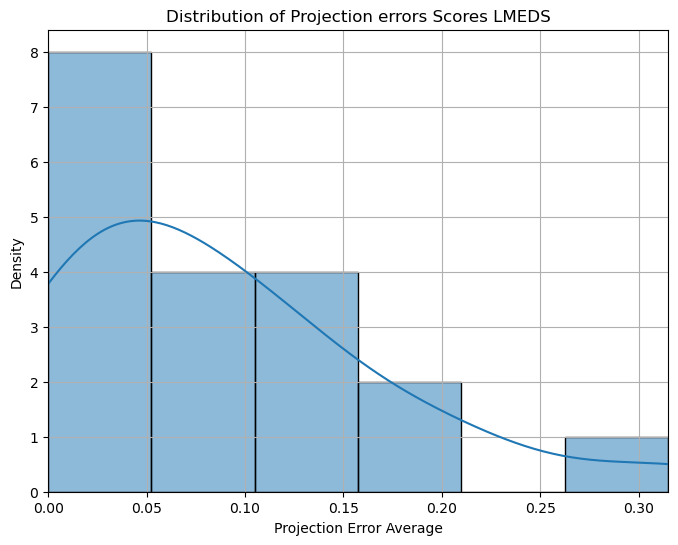

In [38]:
plt.figure(figsize=(8, 6))
sns.histplot(errors, bins='auto',
             kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Projection Error Average")
plt.ylabel("Density")
plt.title("Distribution of Projection errors Scores LMEDS")

plt.grid(True)
plt.xlim(0, max(errors))

# Display the plot
plt.show()

In [39]:
errors.clear()
for i in range(len(names)):
    data = mat_data[names[i]]
    res=compute_inliers_residual_curve(data)

    threshold = thresholds[i]
    average_errors = analyze_reprojection_error(data, threshold, method="ransac", type='FM')
    tmp_vals = average_errors.values()
    min_val = min(tmp_vals)
    idx = 0
    for h in range(len(tmp_vals)):
        if list(tmp_vals)[h] == min_val: idx = h
    min_t = list(average_errors.keys())[idx]
    print("Average reprojection errors for inliers:")
    average_error[min_t] = average_errors.get(min_t)
    for threshold, error in average_errors.items():
        print(f"Threshold: {threshold}, Average Reprojection Error: {error:.4f}")
          #errors.append(error)
    errors.append(average_error[min_t])

IndexError: index 1 is out of bounds for axis 0 with size 1

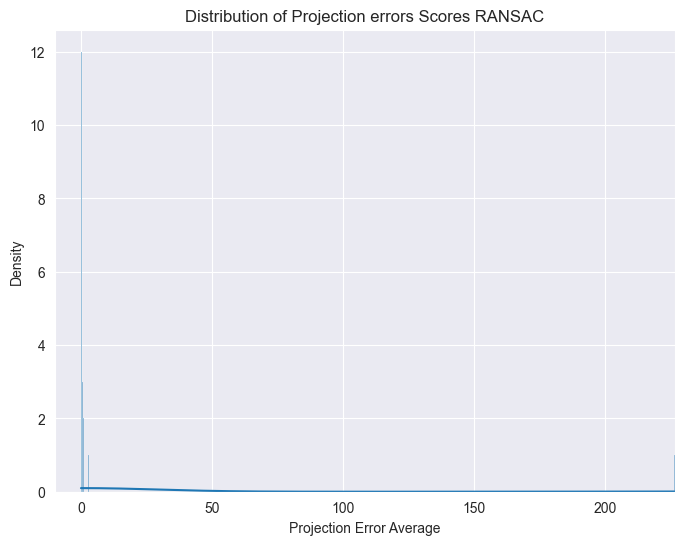

In [ ]:
plt.figure(figsize=(8, 6))
sns.histplot(errors, bins='auto',
             kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Projection Error Average")
plt.ylabel("Density")
plt.title("Distribution of Projection errors Scores RANSAC")

plt.grid(True)
plt.xlim(-10, max(errors))

# Display the plot
plt.show()

69.0 inliers found
the total number of point is:  71
The indexes of outlier points are: [6, 237]


<Figure size 640x480 with 0 Axes>

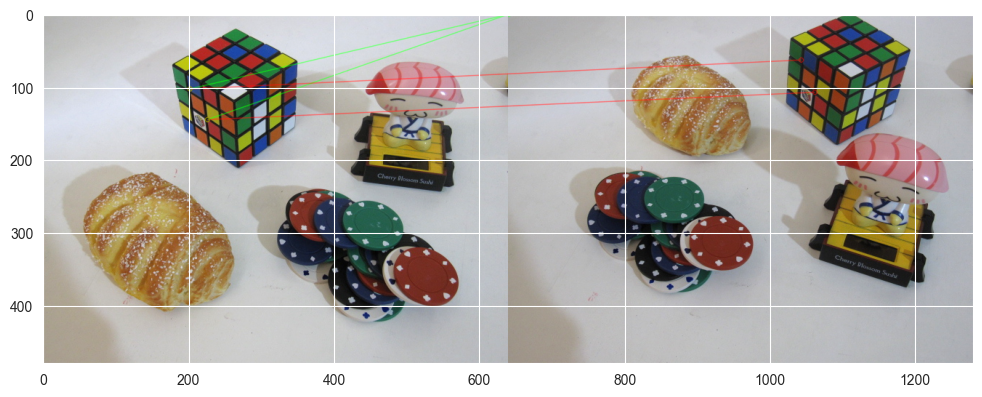

49.0 inliers found
the total number of point is:  49
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

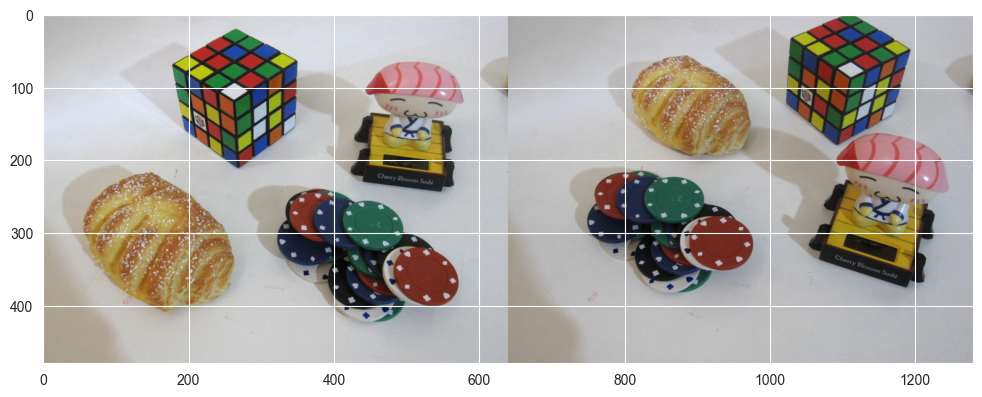

36.0 inliers found
the total number of point is:  38
The indexes of outlier points are: [166, 218]


<Figure size 640x480 with 0 Axes>

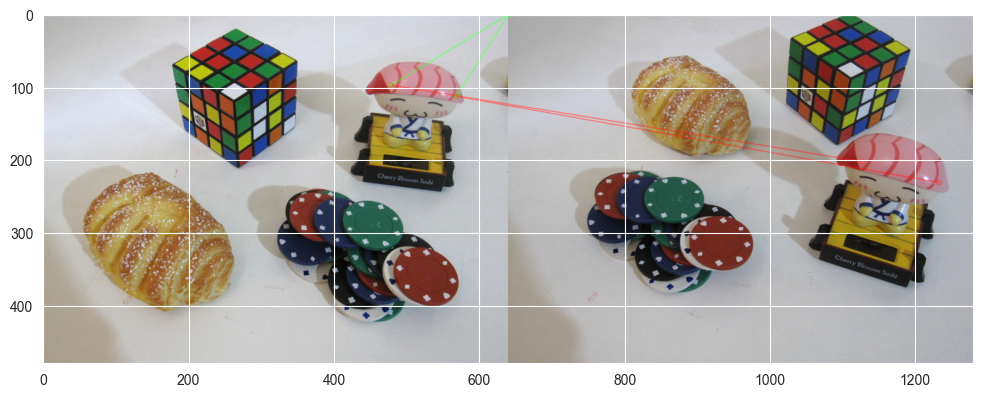

80.0 inliers found
the total number of point is:  81
The indexes of outlier points are: [28]


<Figure size 640x480 with 0 Axes>

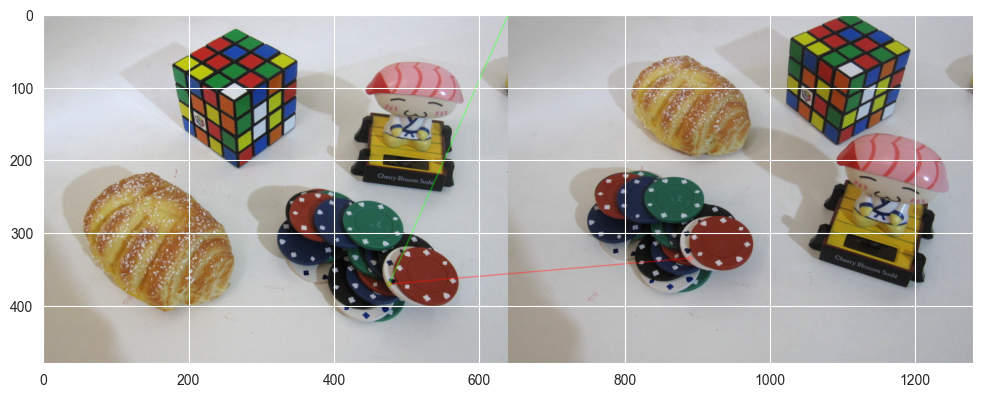

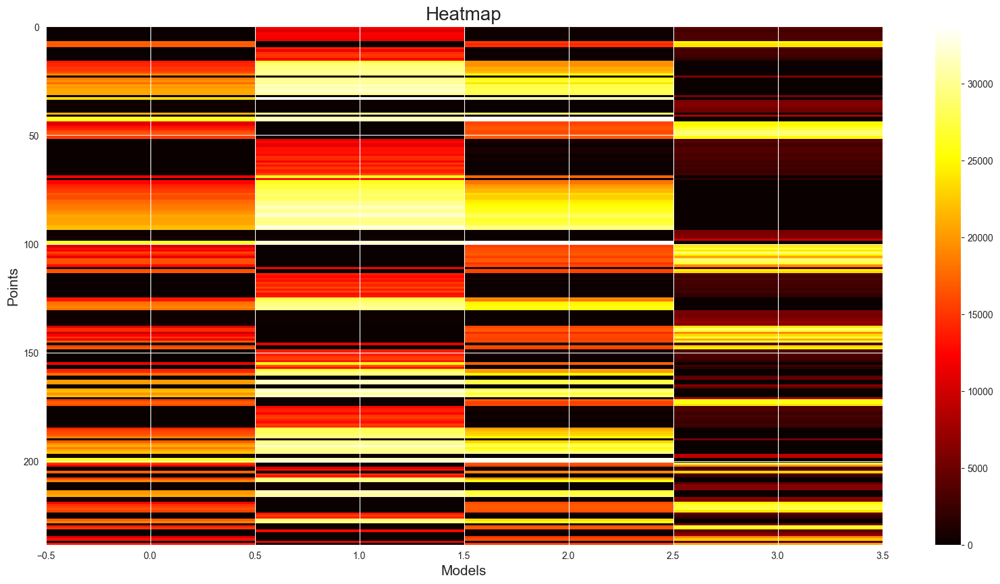

78.0 inliers found
the total number of point is:  78
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

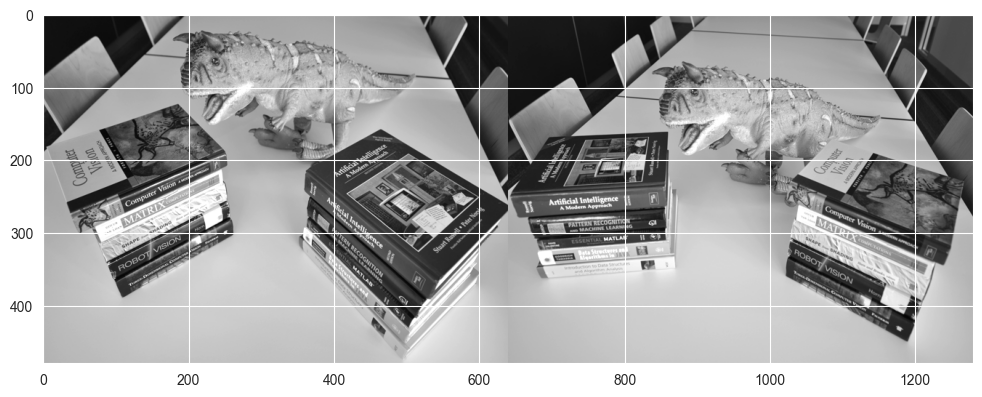

86.0 inliers found
the total number of point is:  86
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

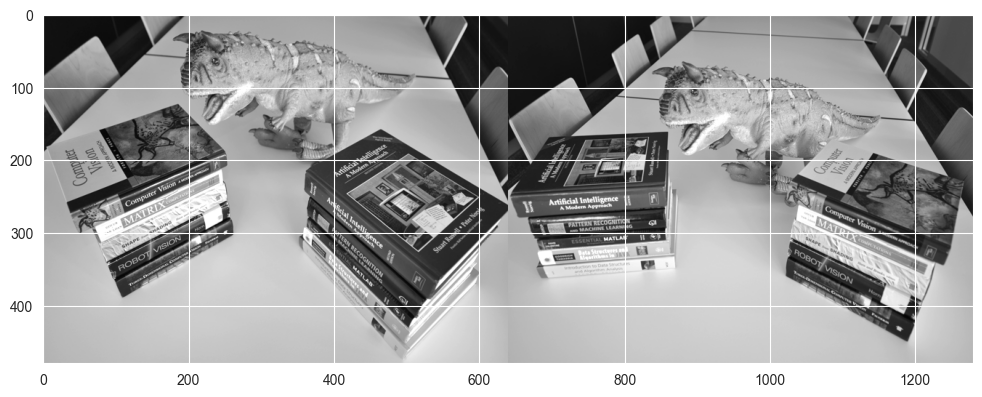

41.0 inliers found
the total number of point is:  41
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

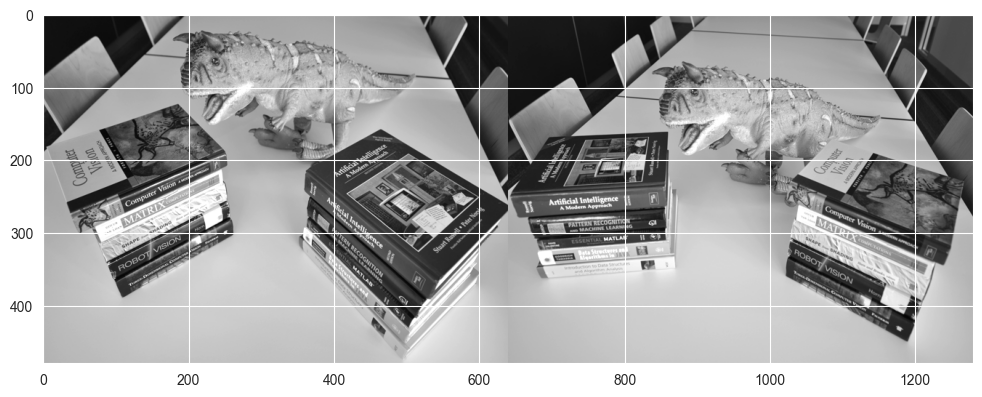

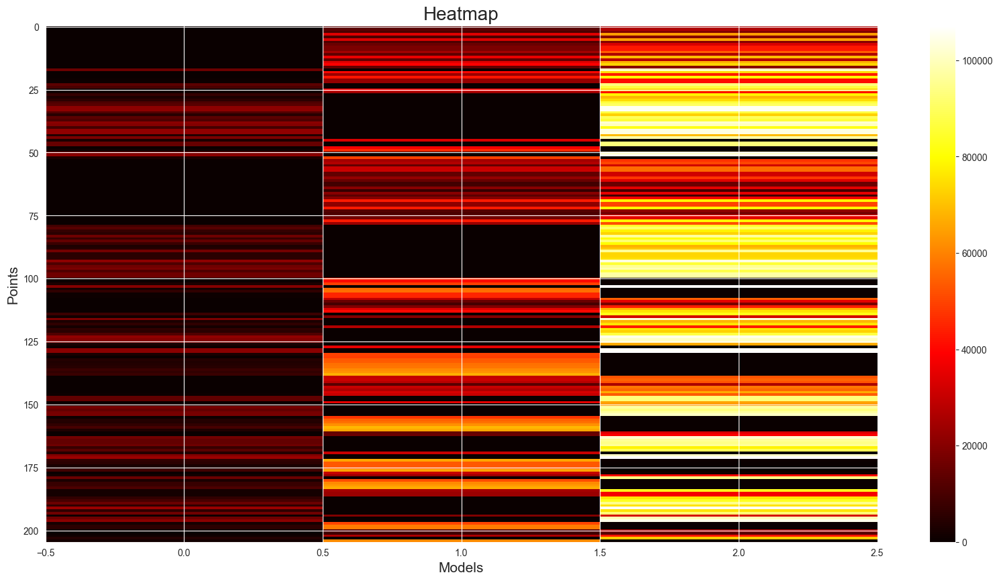

126.0 inliers found
the total number of point is:  146
The indexes of outlier points are: [0, 1, 6, 16, 38, 63, 66, 93, 96, 99, 103, 104, 103, 104, 106, 114, 132, 134, 136, 140, 141, 144]


<Figure size 640x480 with 0 Axes>

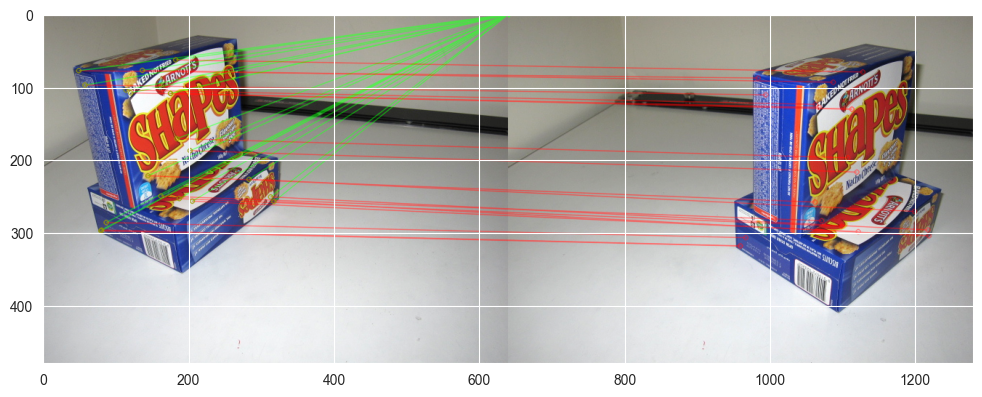

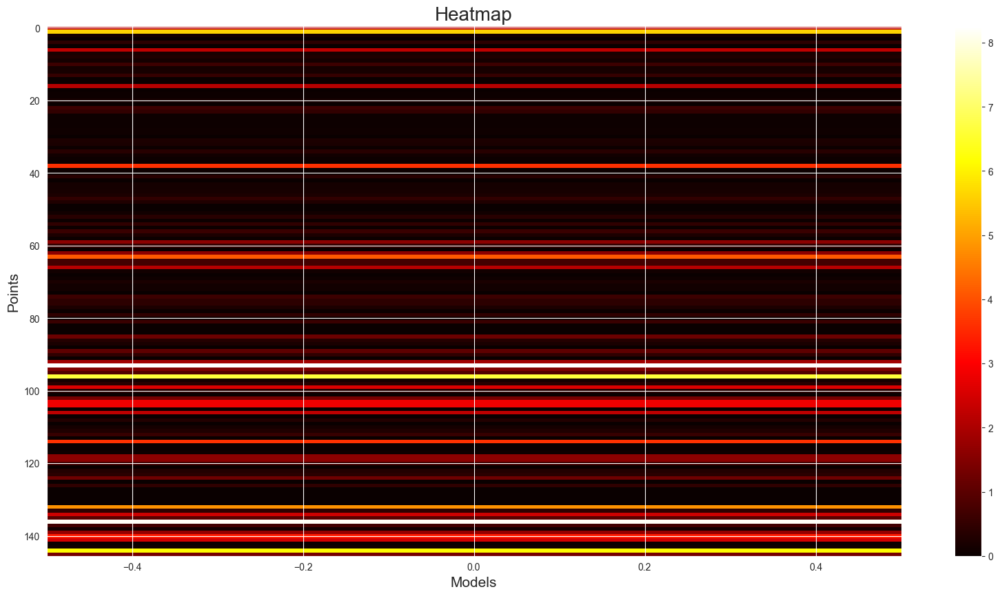

53.0 inliers found
the total number of point is:  63
The indexes of outlier points are: [23, 29, 45, 51, 52, 51, 52, 53, 56, 59, 61, 62]


<Figure size 640x480 with 0 Axes>

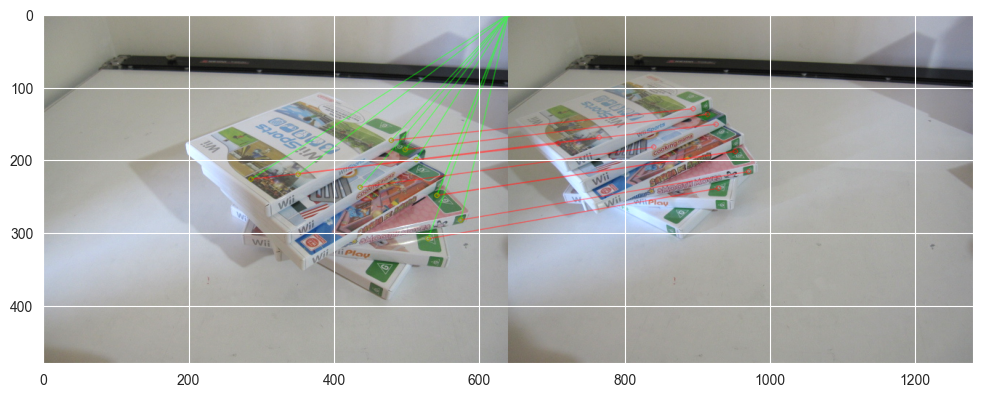

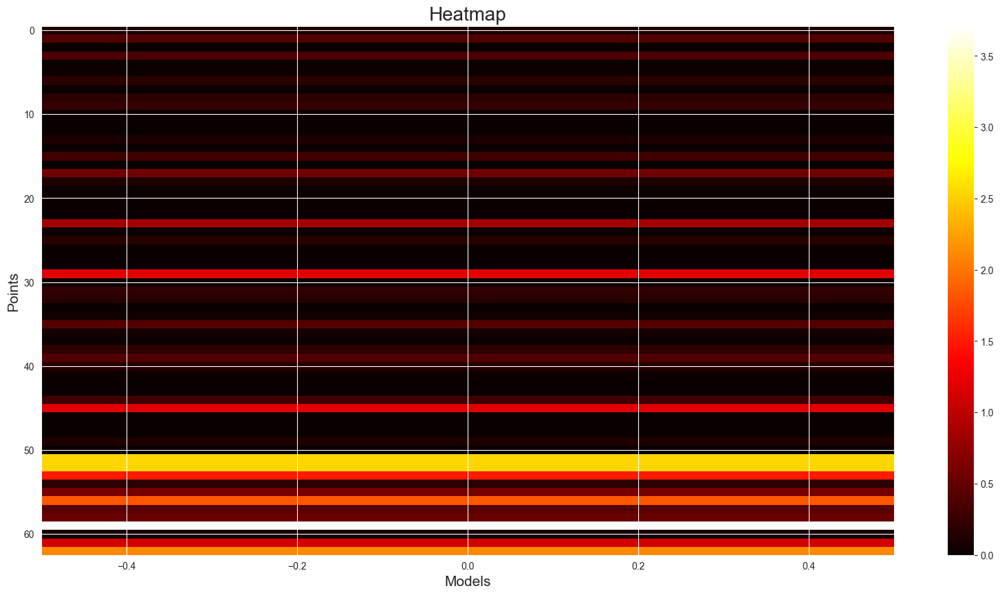

93.0 inliers found
the total number of point is:  97
The indexes of outlier points are: [27, 36, 44, 95]


<Figure size 640x480 with 0 Axes>

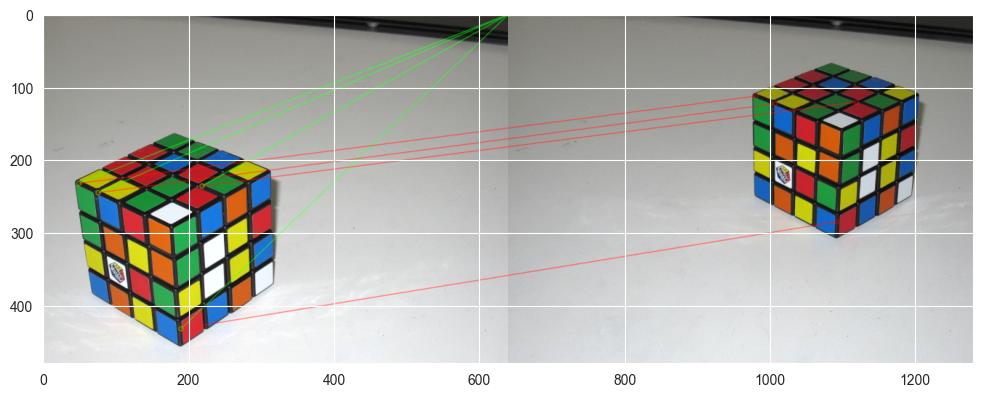

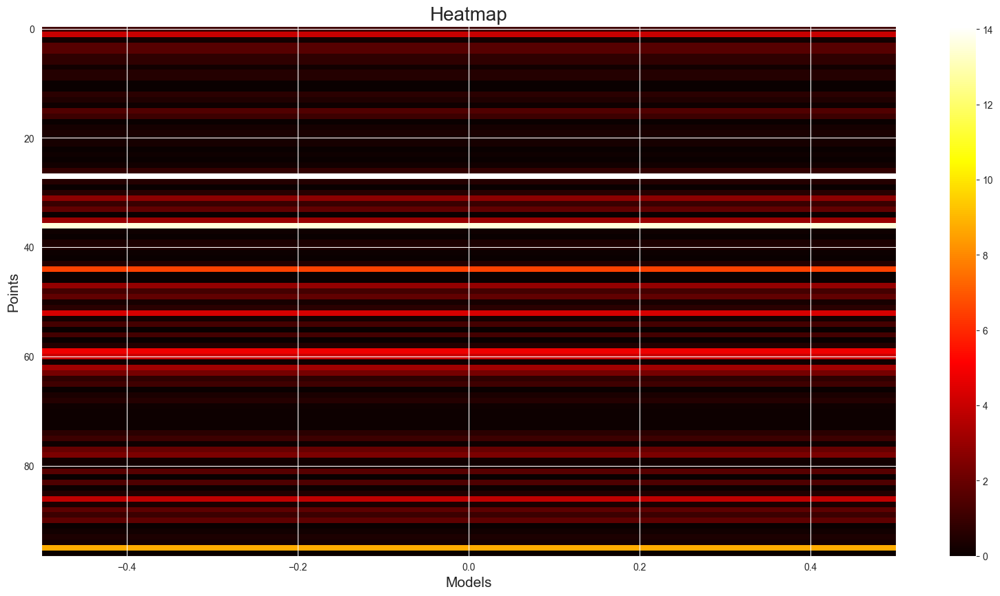

92.0 inliers found
the total number of point is:  105
The indexes of outlier points are: [1, 3, 5, 13, 18, 50, 60, 66, 68, 72, 82, 90, 101]


<Figure size 640x480 with 0 Axes>

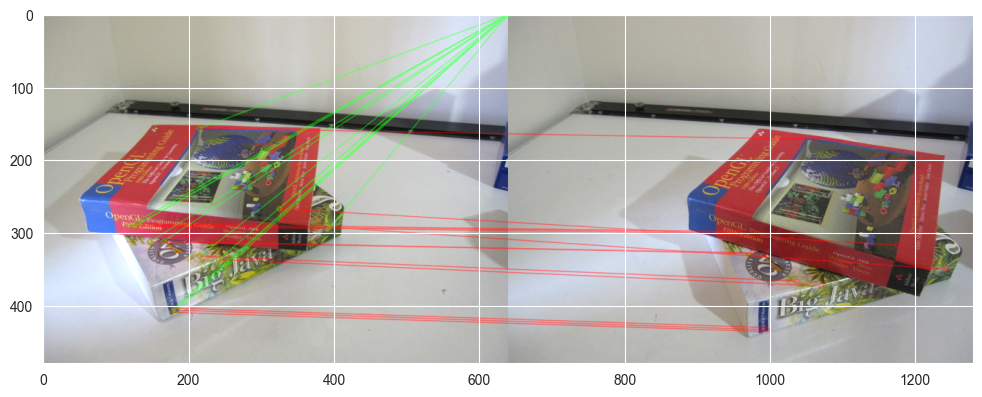

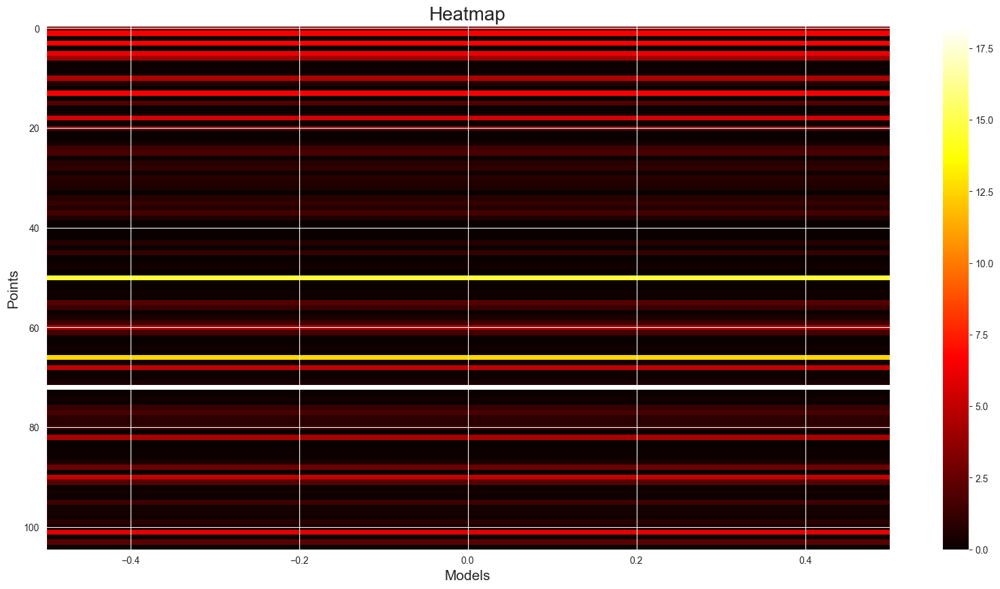

37.0 inliers found
the total number of point is:  37
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

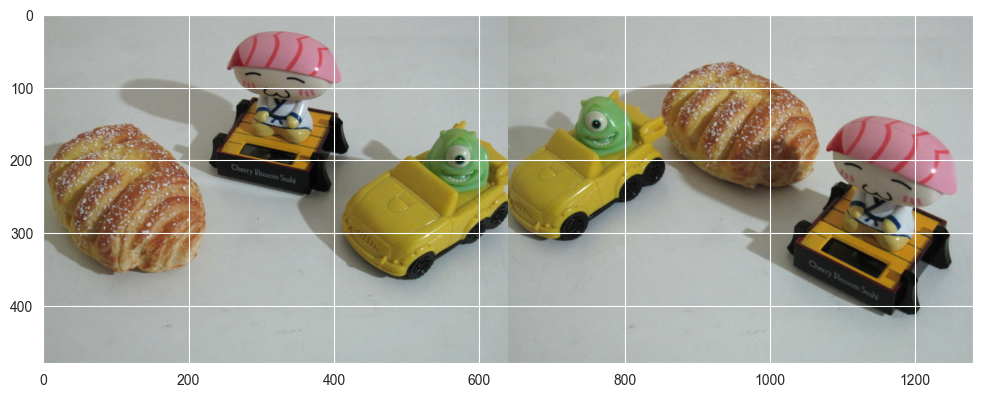

39.0 inliers found
the total number of point is:  39
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

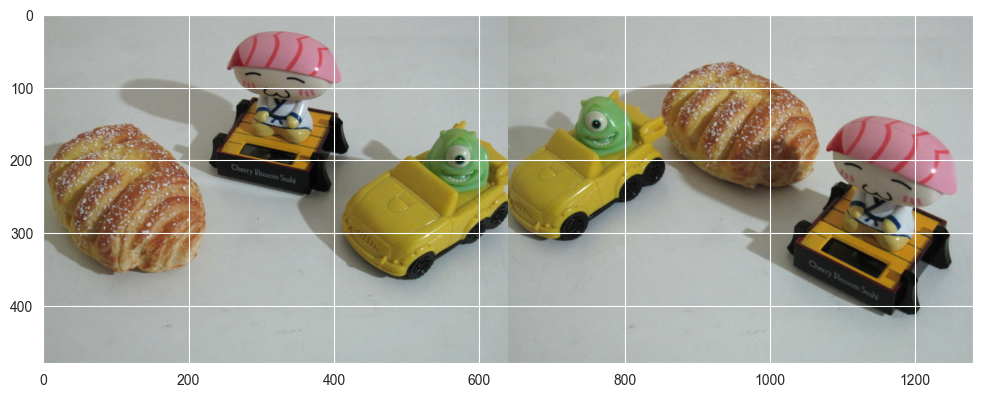

34.0 inliers found
the total number of point is:  34
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

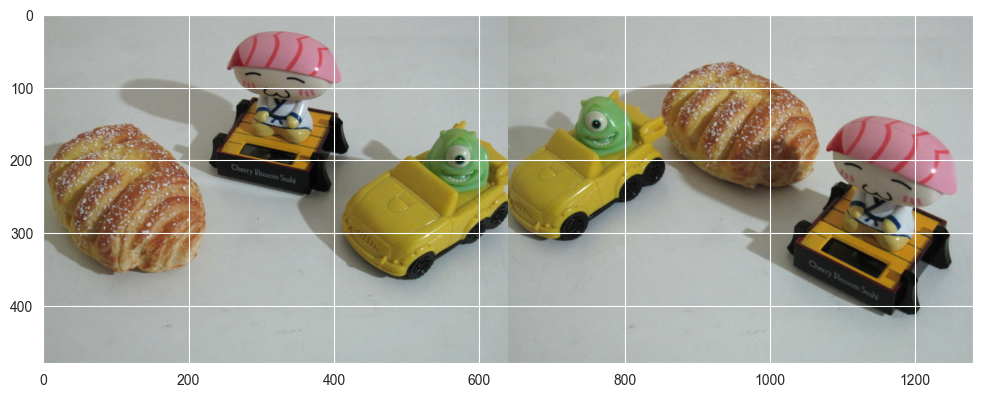

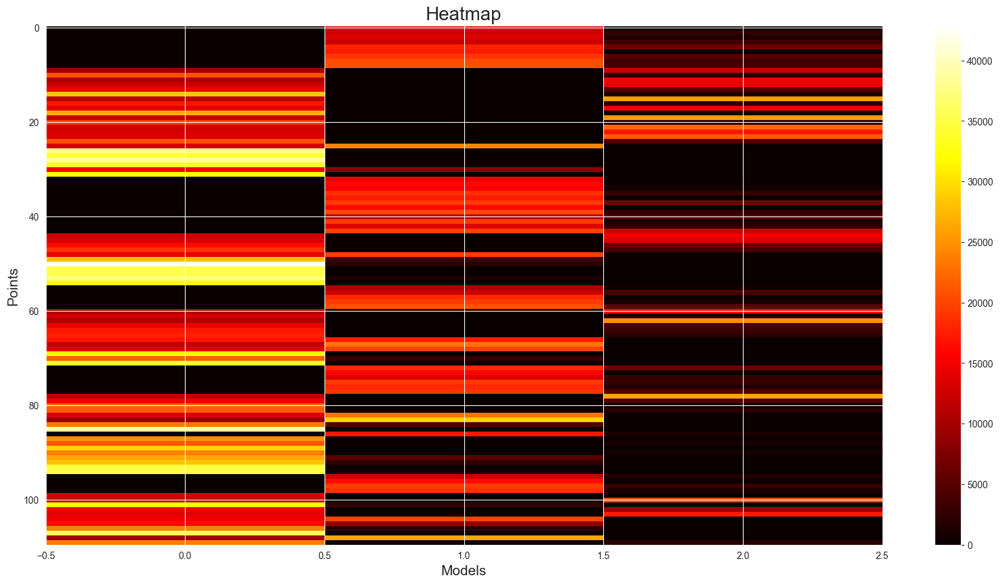

63.0 inliers found
the total number of point is:  73
The indexes of outlier points are: [49, 69, 70, 69, 70, 82, 113, 114, 128, 141, 149, 156]


<Figure size 640x480 with 0 Axes>

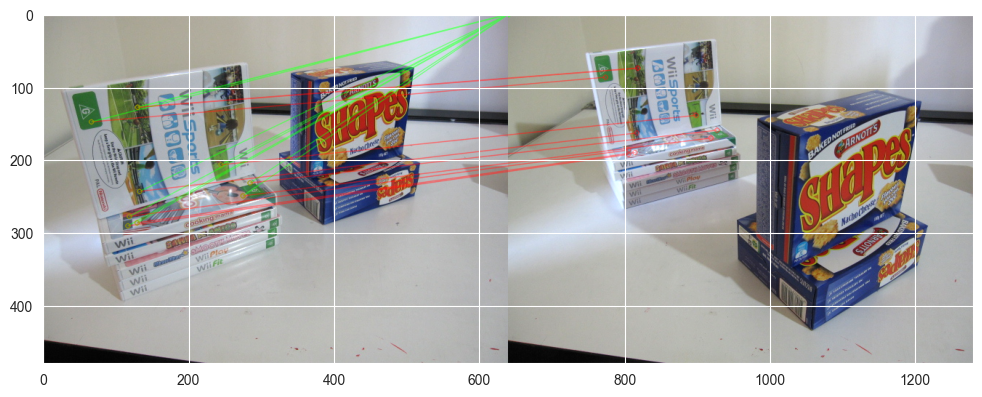

88.0 inliers found
the total number of point is:  88
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

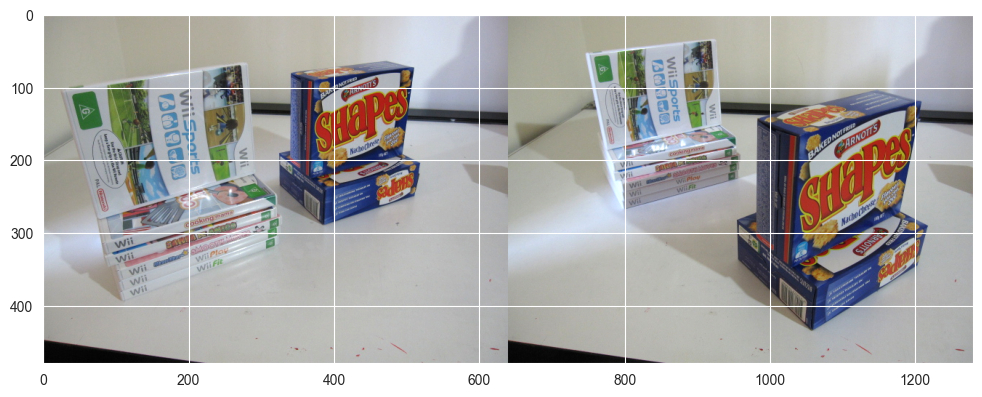

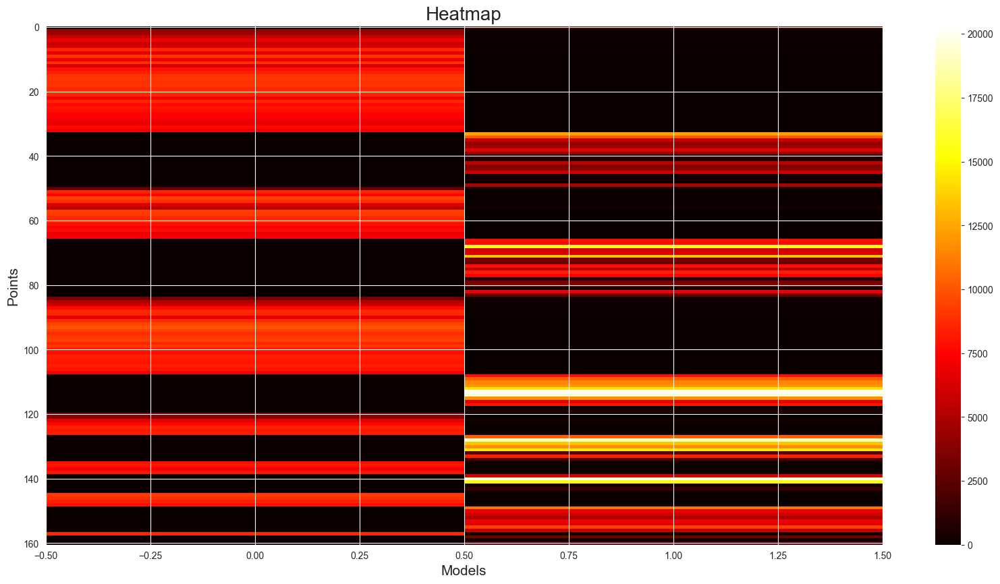

45.0 inliers found
the total number of point is:  45
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

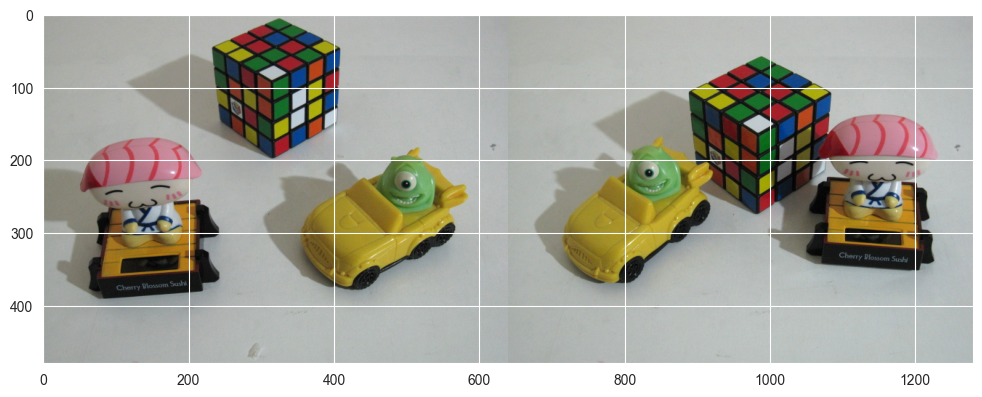

67.0 inliers found
the total number of point is:  69
The indexes of outlier points are: [46, 114]


<Figure size 640x480 with 0 Axes>

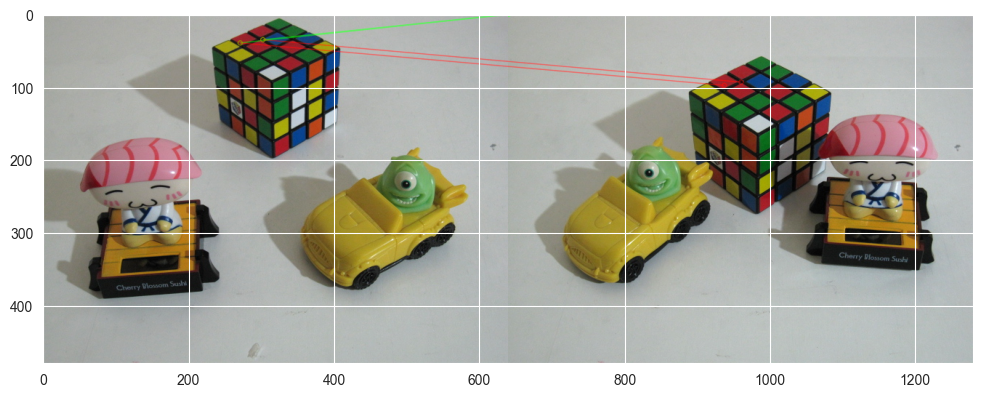

8.0 inliers found
the total number of point is:  14
The indexes of outlier points are: [24, 27, 59, 78, 79, 124]


<Figure size 640x480 with 0 Axes>

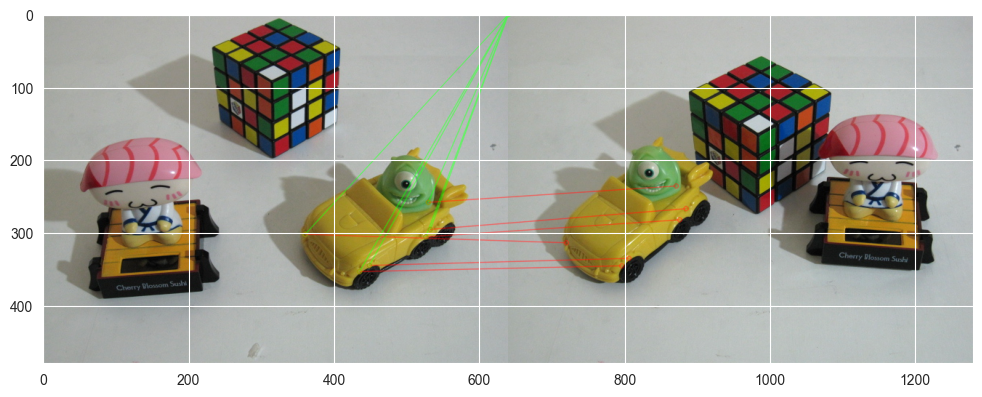

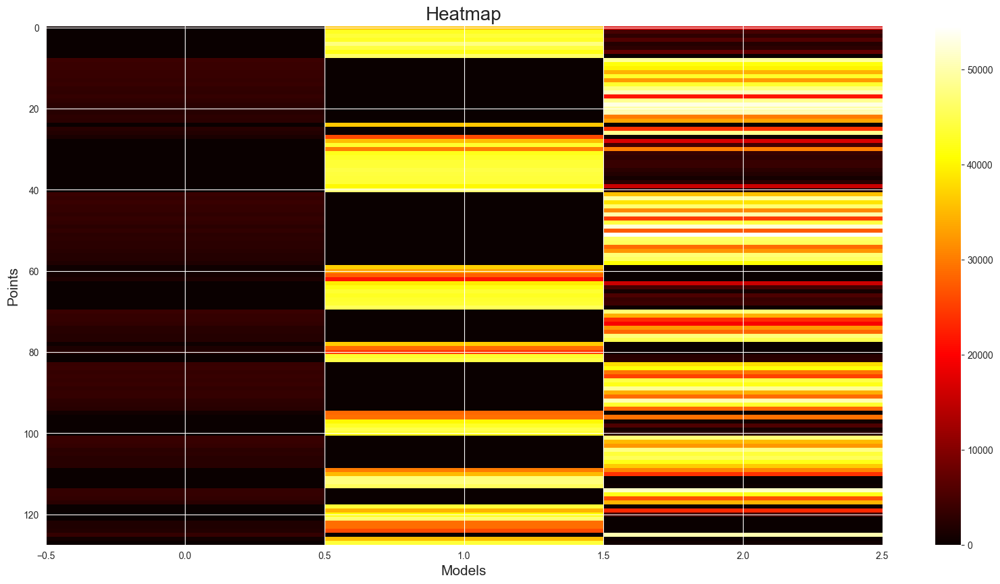

60.0 inliers found
the total number of point is:  67
The indexes of outlier points are: [5, 14, 56, 104, 138, 145, 155]


<Figure size 640x480 with 0 Axes>

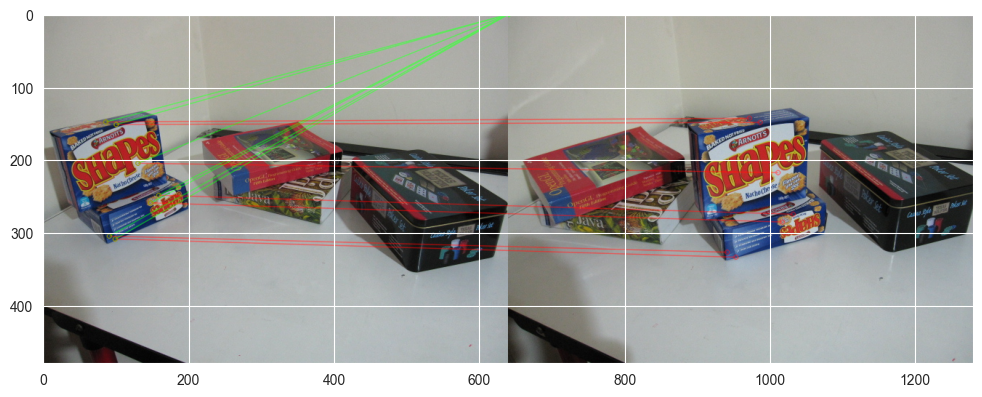

35.0 inliers found
the total number of point is:  41
The indexes of outlier points are: [24, 25, 26, 71, 126, 158]


<Figure size 640x480 with 0 Axes>

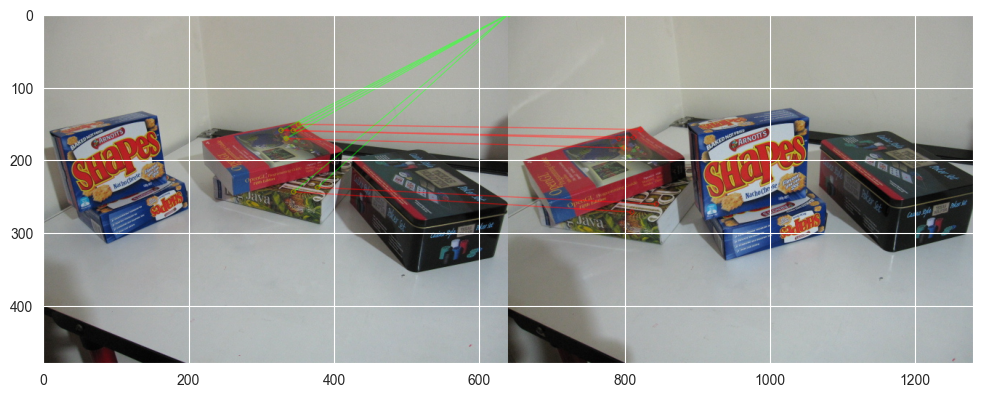

41.0 inliers found
the total number of point is:  54
The indexes of outlier points are: [42, 76, 77, 79, 80, 81, 82, 87, 90, 91, 116, 136, 151]


<Figure size 640x480 with 0 Axes>

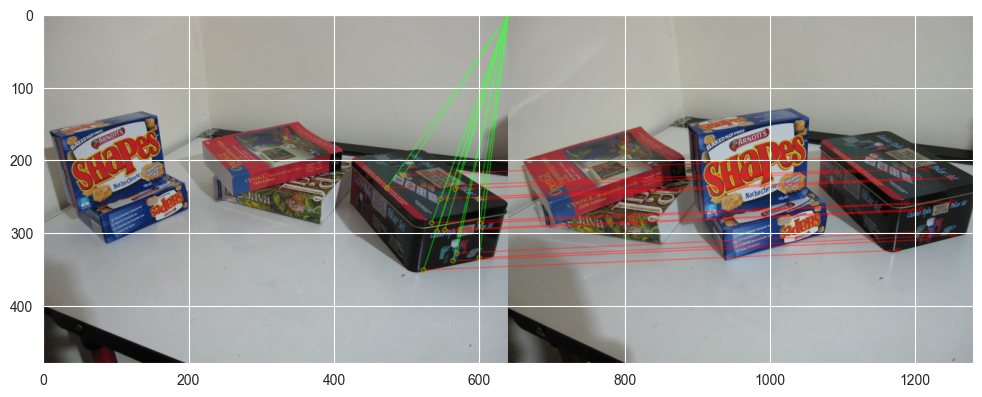

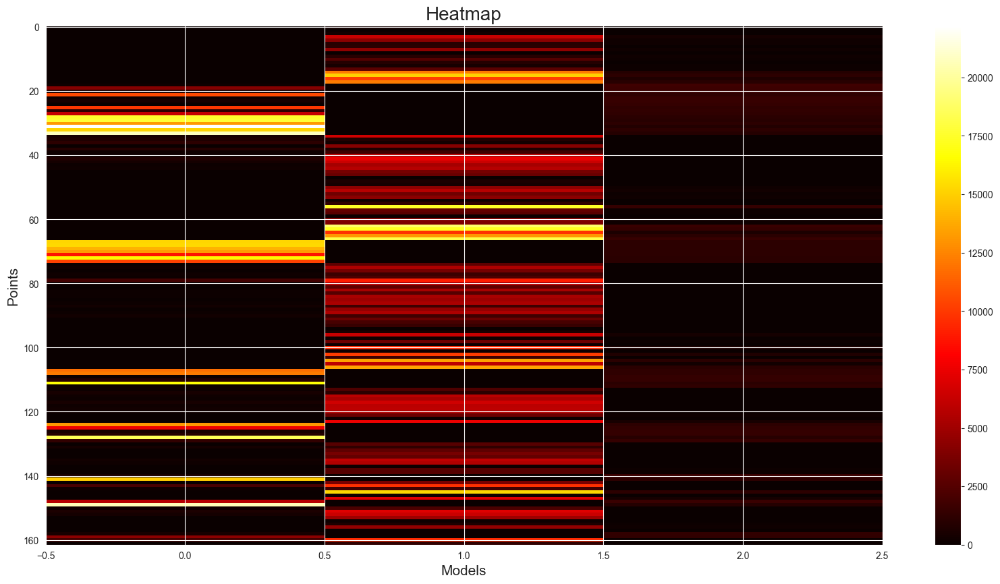

34.0 inliers found
the total number of point is:  34
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

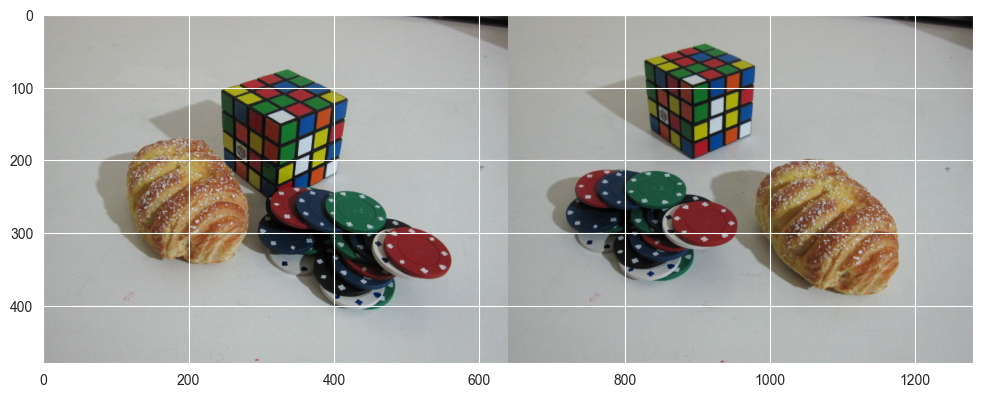

45.0 inliers found
the total number of point is:  57
The indexes of outlier points are: [39, 76, 80, 86, 87, 106, 113, 127, 136, 137, 139, 147]


<Figure size 640x480 with 0 Axes>

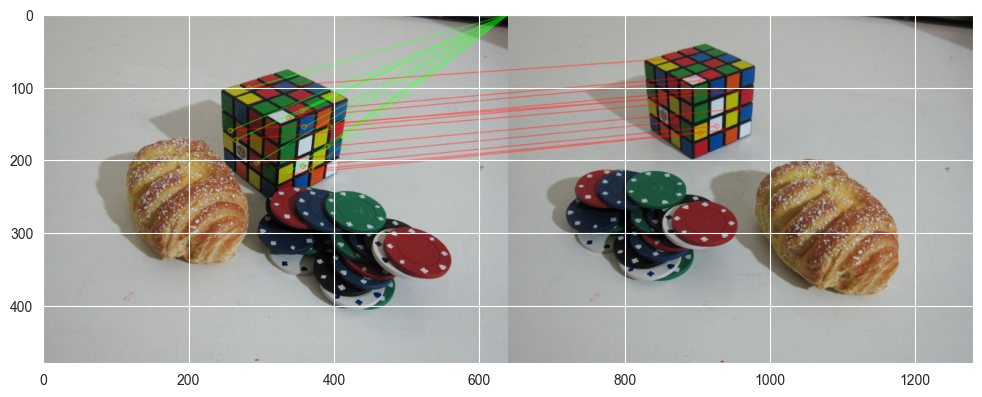

46.0 inliers found
the total number of point is:  58
The indexes of outlier points are: [33, 49, 58, 61, 63, 64, 65, 81, 84, 132, 142, 144]


<Figure size 640x480 with 0 Axes>

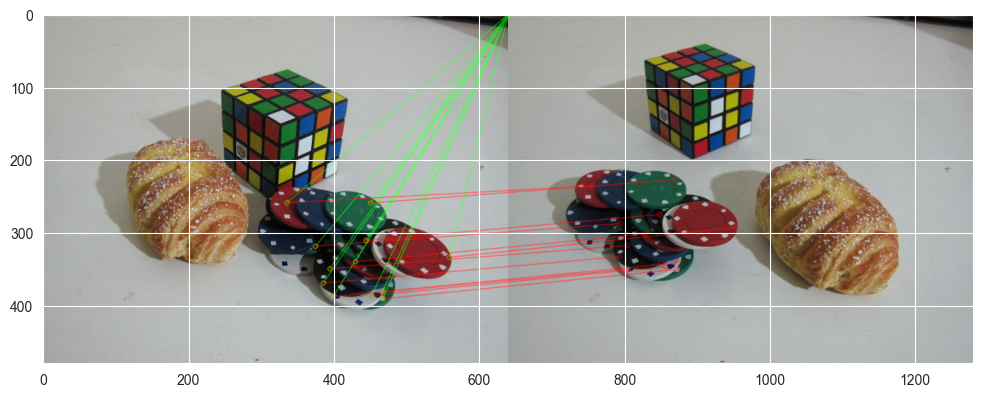

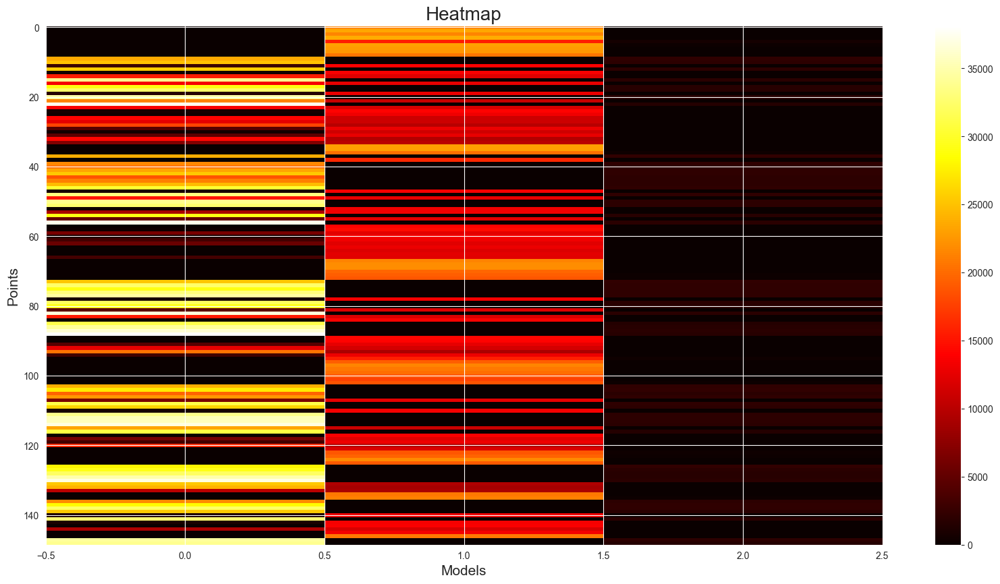

30.0 inliers found
the total number of point is:  33
The indexes of outlier points are: [7, 74, 77]


<Figure size 640x480 with 0 Axes>

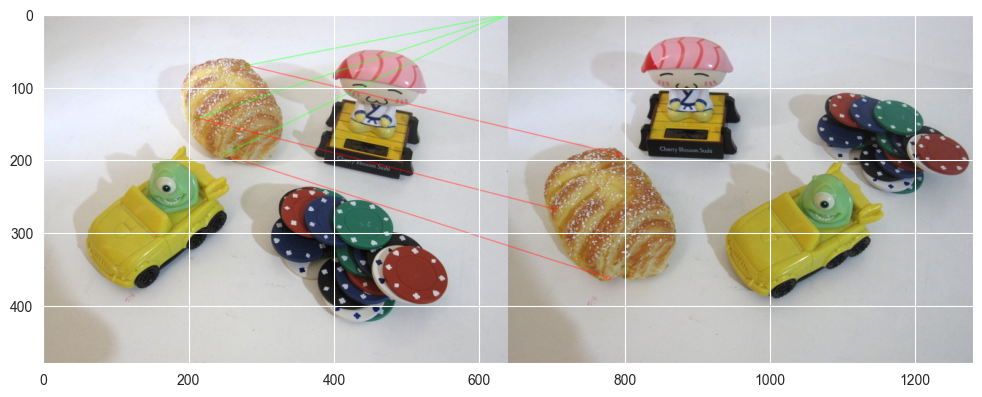

23.0 inliers found
the total number of point is:  23
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

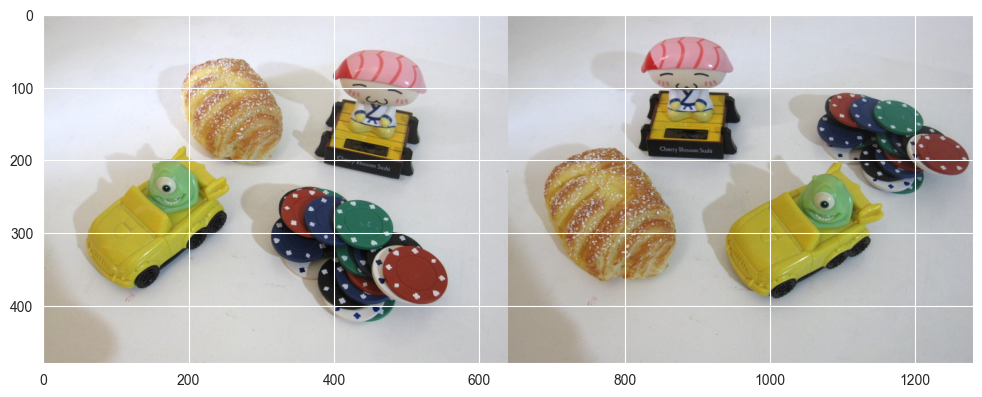

37.0 inliers found
the total number of point is:  41
The indexes of outlier points are: [64, 92, 144, 149]


<Figure size 640x480 with 0 Axes>

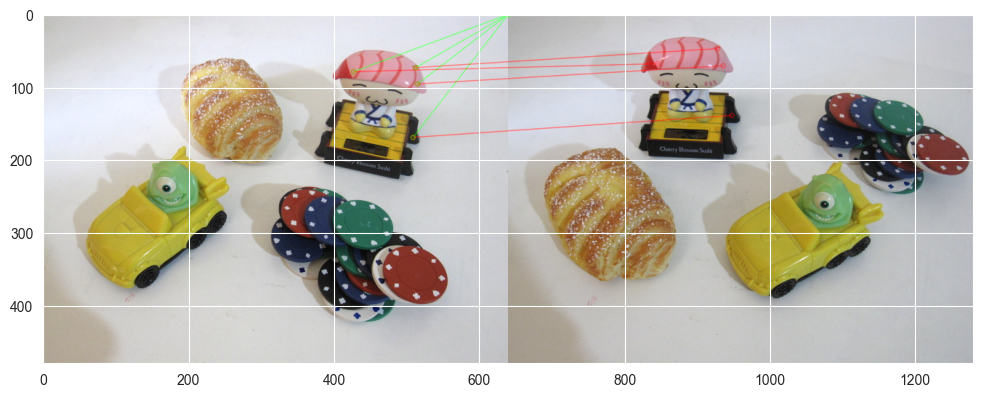

58.0 inliers found
the total number of point is:  58
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

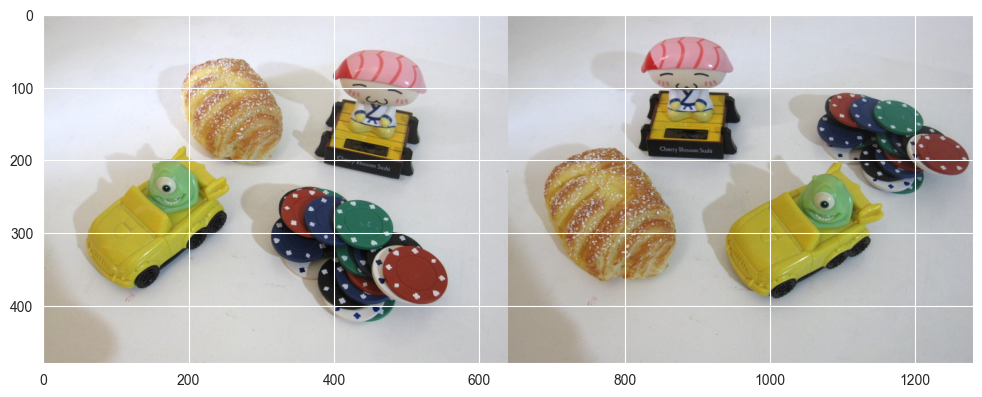

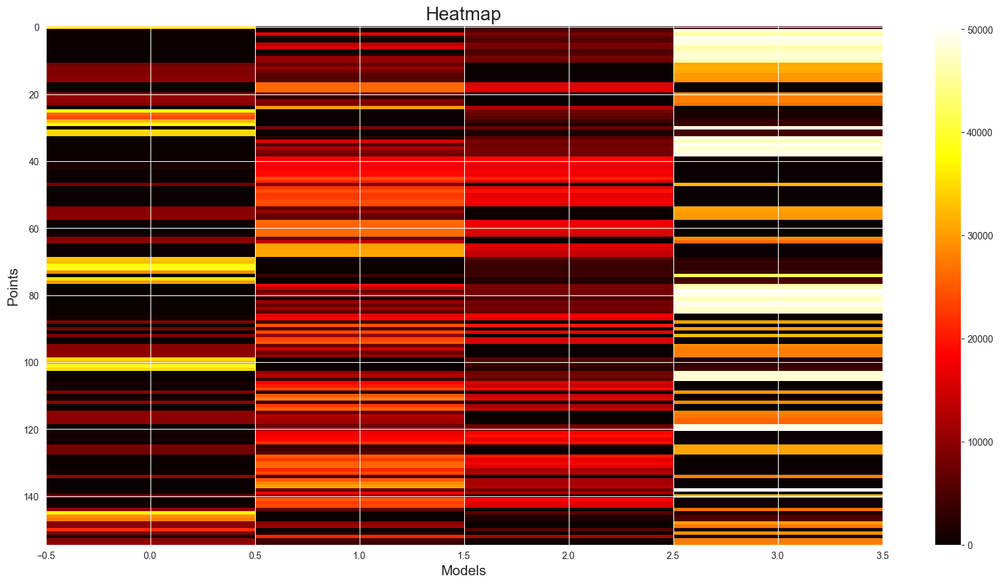

87.0 inliers found
the total number of point is:  97
The indexes of outlier points are: [1, 2, 6, 8, 10, 93, 122, 130, 167, 176]


<Figure size 640x480 with 0 Axes>

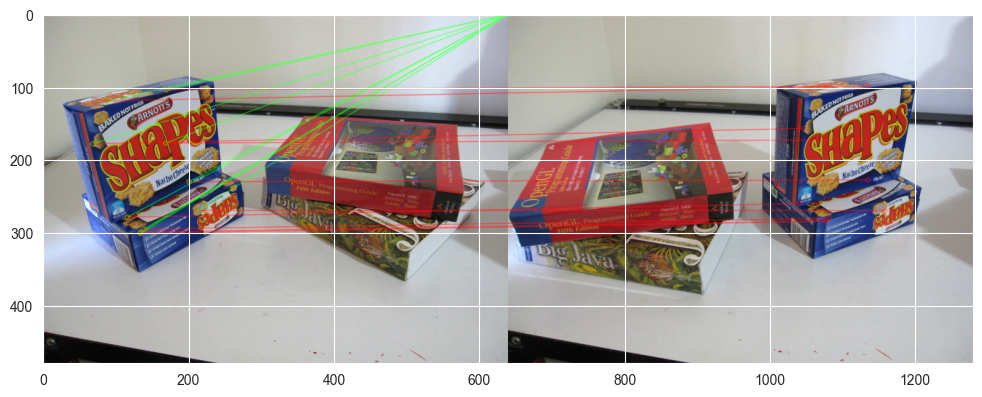

69.0 inliers found
the total number of point is:  82
The indexes of outlier points are: [28, 45, 48, 75, 79, 85, 108, 142, 149, 157, 163, 169, 177]


<Figure size 640x480 with 0 Axes>

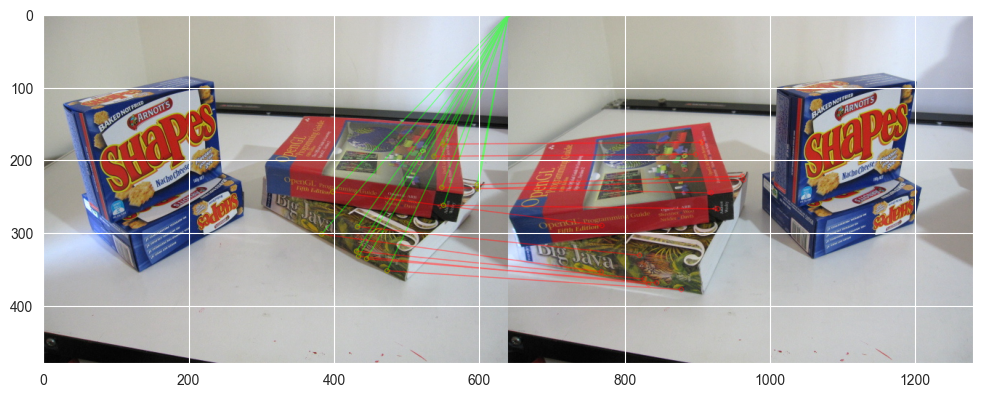

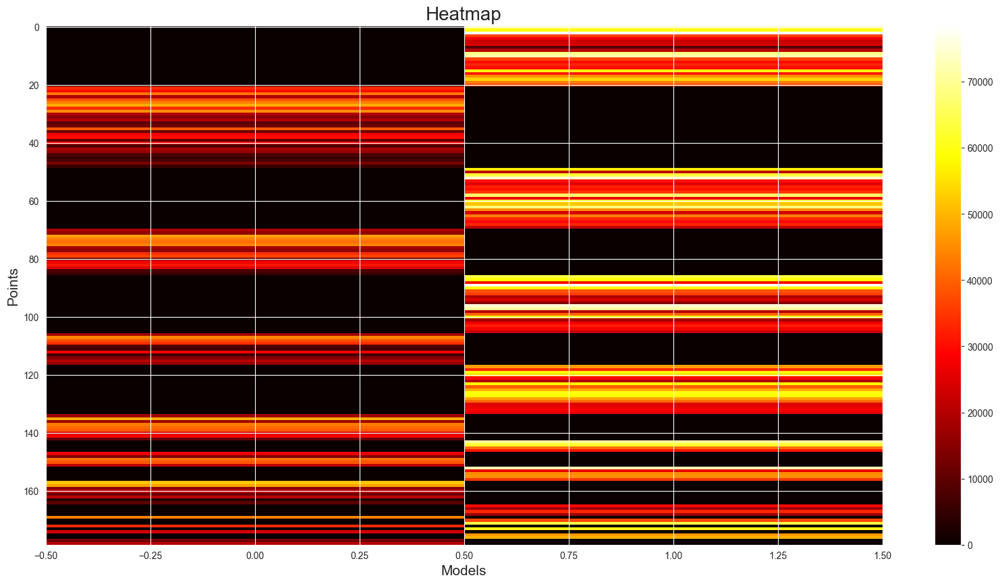

69.0 inliers found
the total number of point is:  69
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

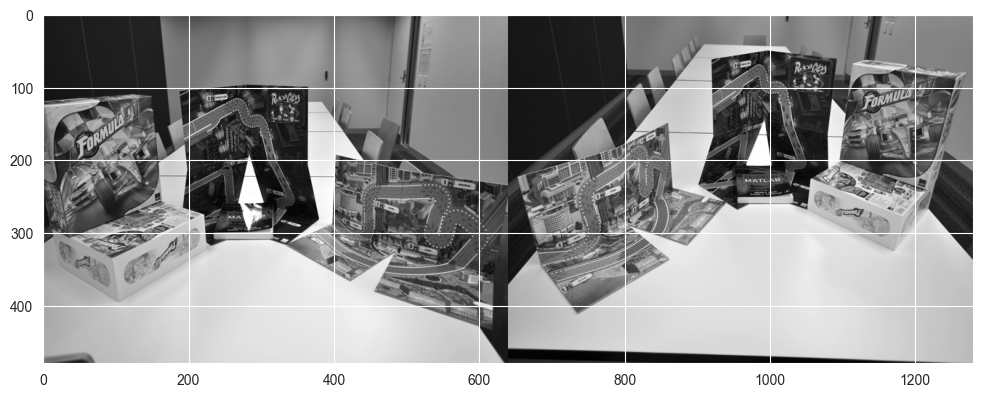

68.0 inliers found
the total number of point is:  68
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

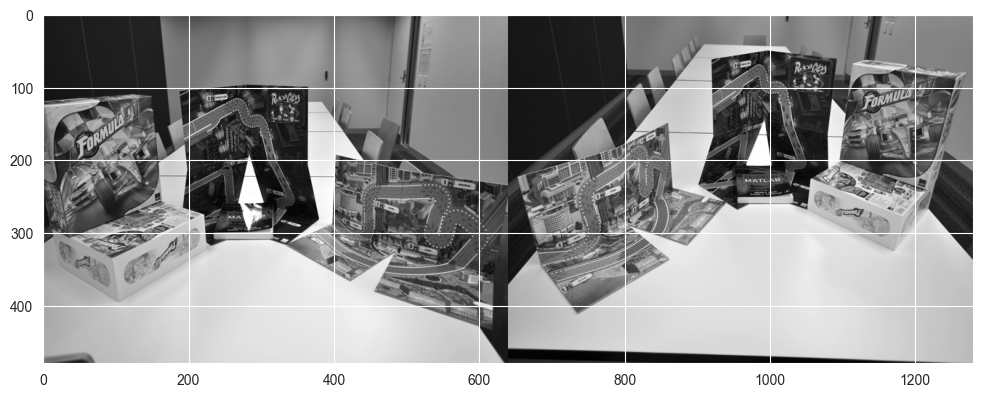

29.0 inliers found
the total number of point is:  29
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

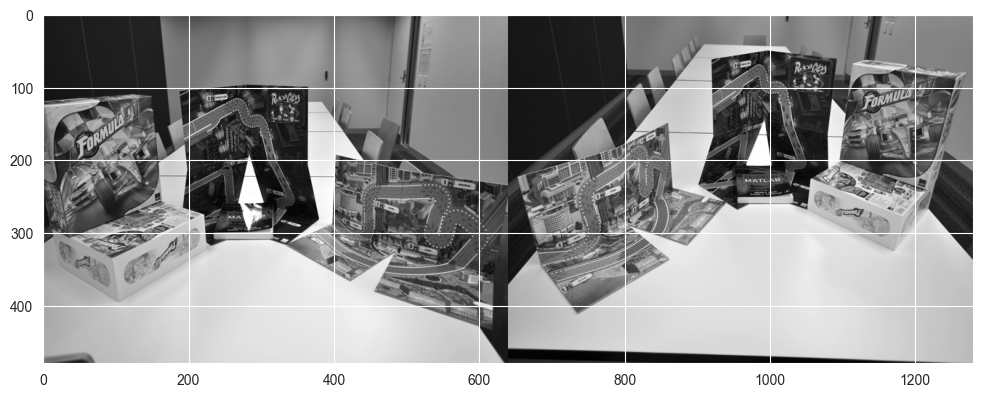

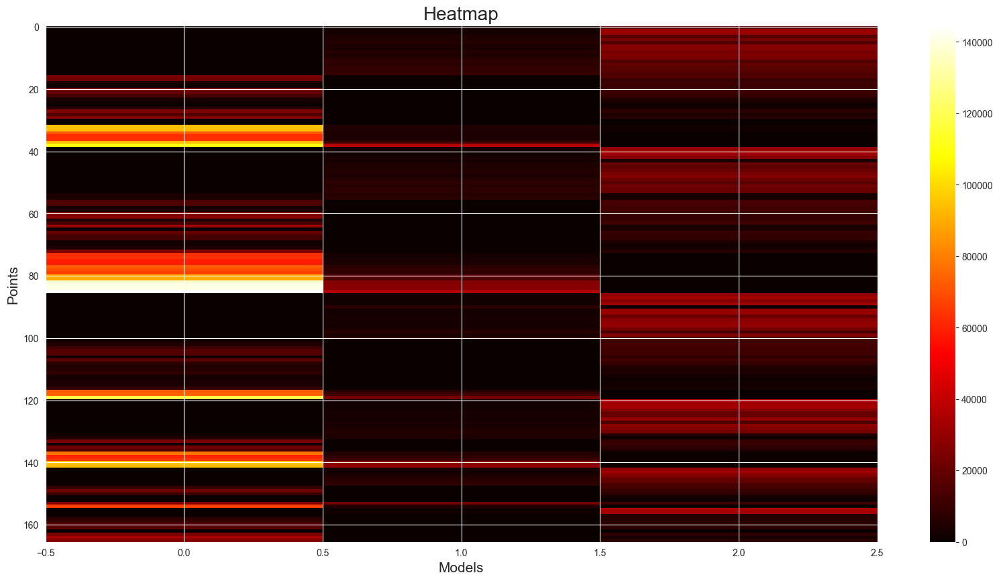

82.0 inliers found
the total number of point is:  84
The indexes of outlier points are: [128, 137]


<Figure size 640x480 with 0 Axes>

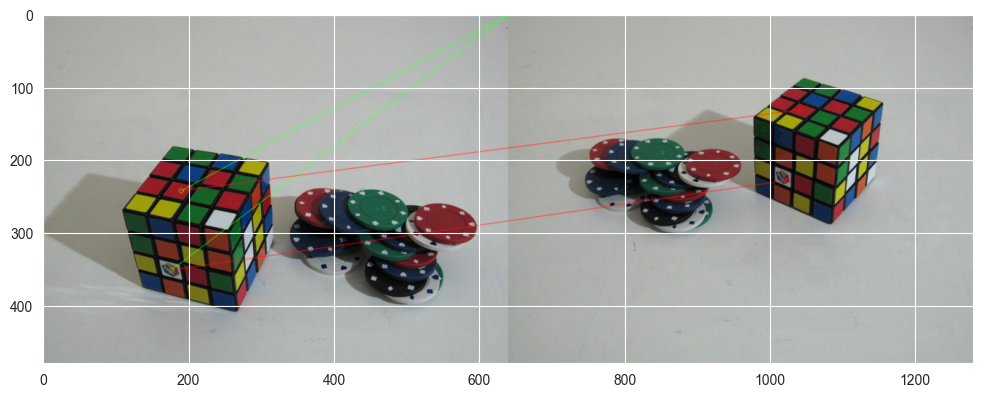

57.0 inliers found
the total number of point is:  57
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

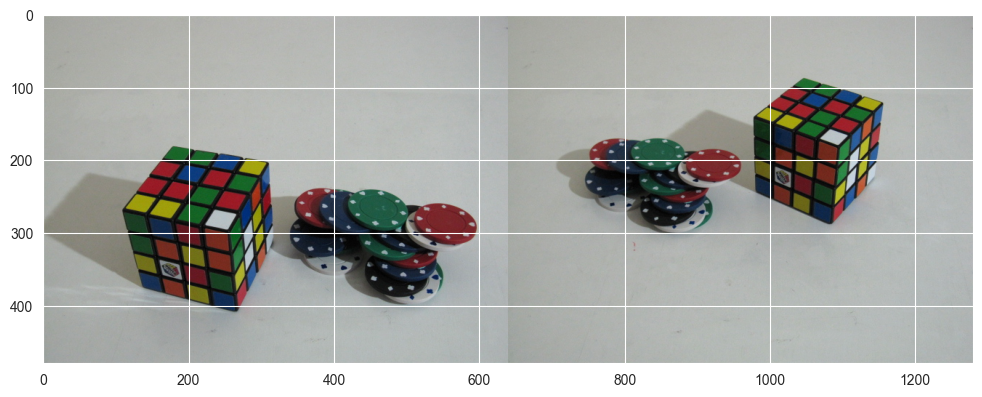

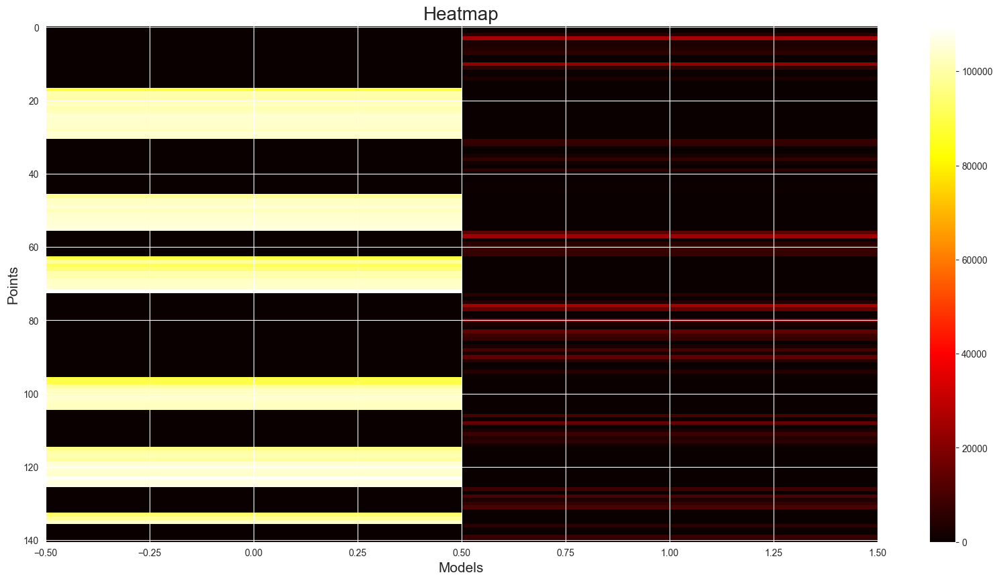

19.0 inliers found
the total number of point is:  19
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

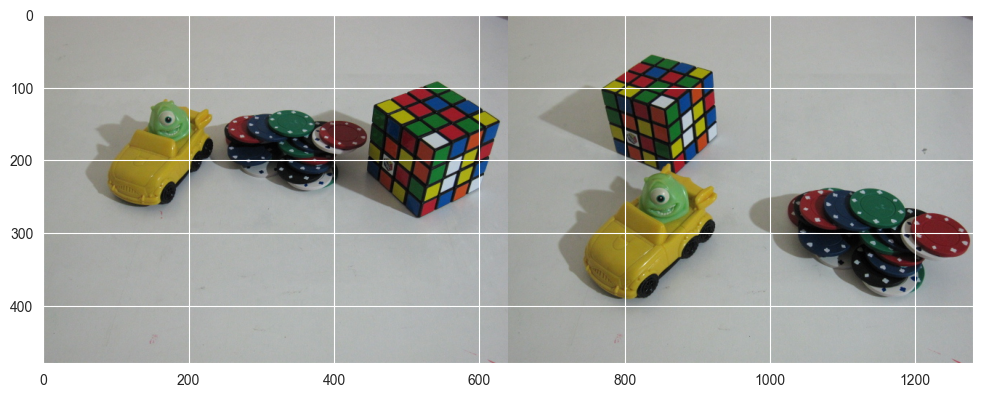

33.0 inliers found
the total number of point is:  33
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

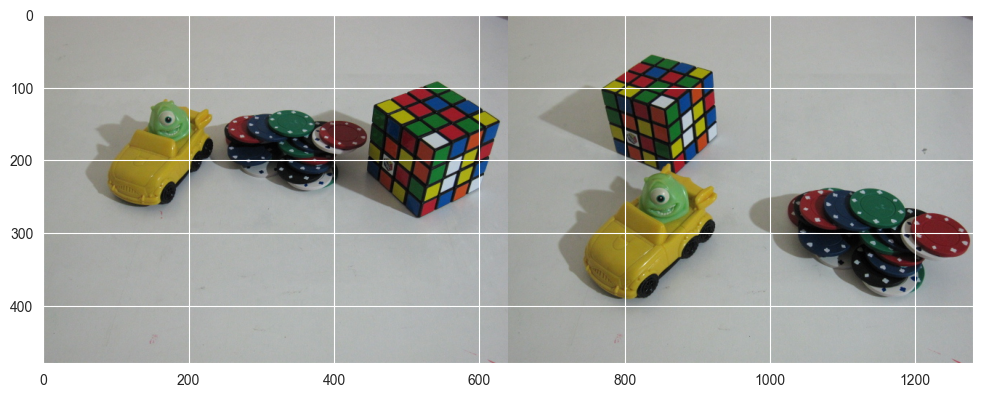

51.0 inliers found
the total number of point is:  53
The indexes of outlier points are: [21, 23]


<Figure size 640x480 with 0 Axes>

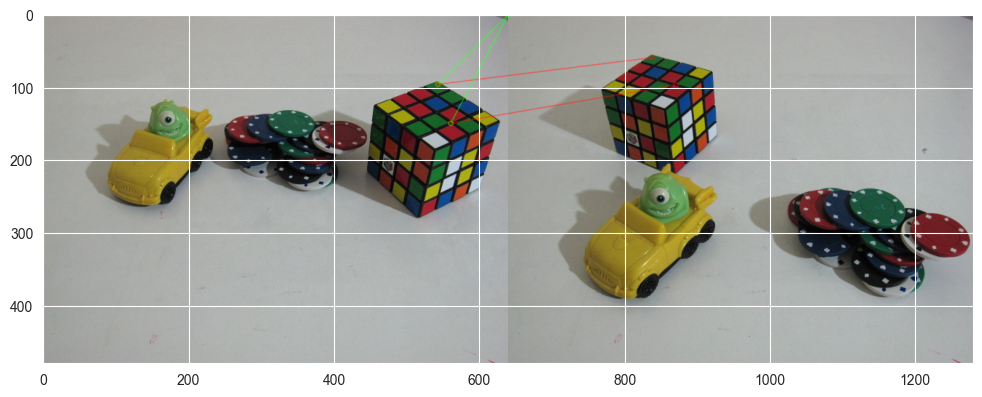

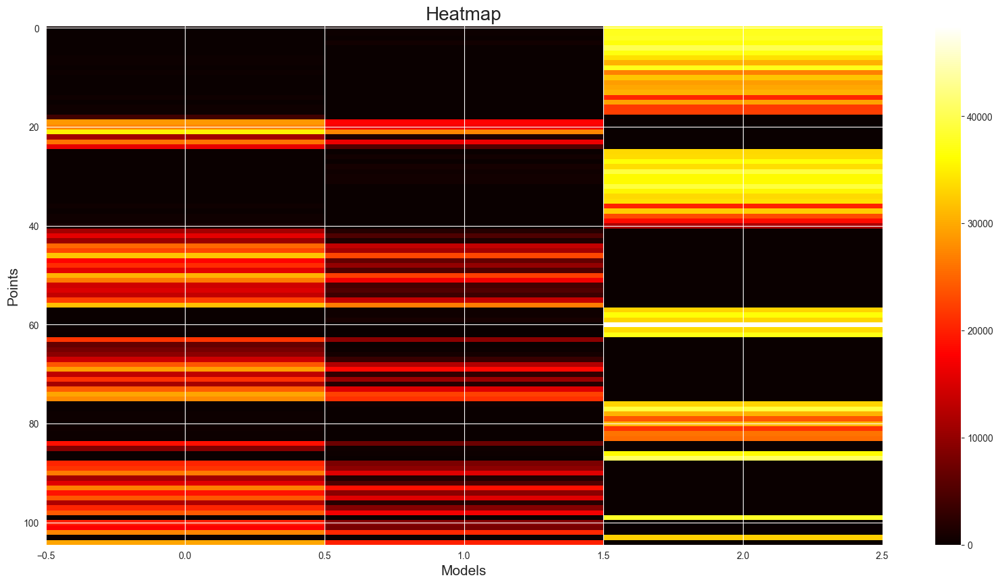

77.0 inliers found
the total number of point is:  78
The indexes of outlier points are: [69]


<Figure size 640x480 with 0 Axes>

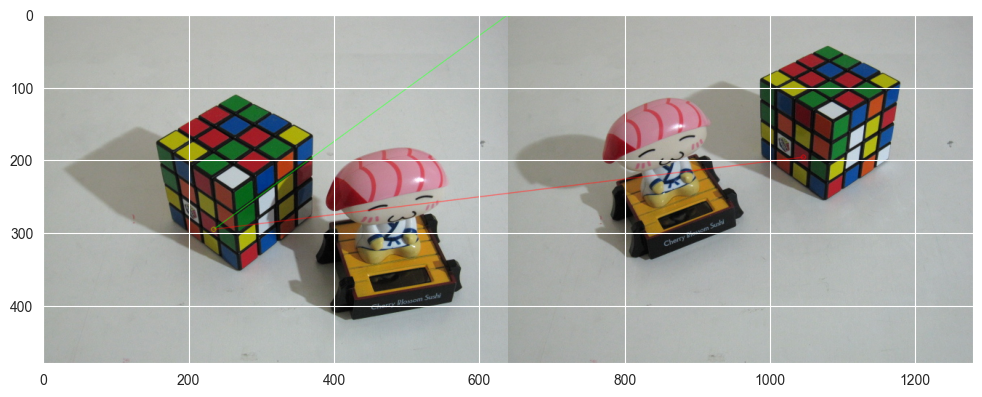

68.0 inliers found
the total number of point is:  72
The indexes of outlier points are: [47, 78, 79, 132]


<Figure size 640x480 with 0 Axes>

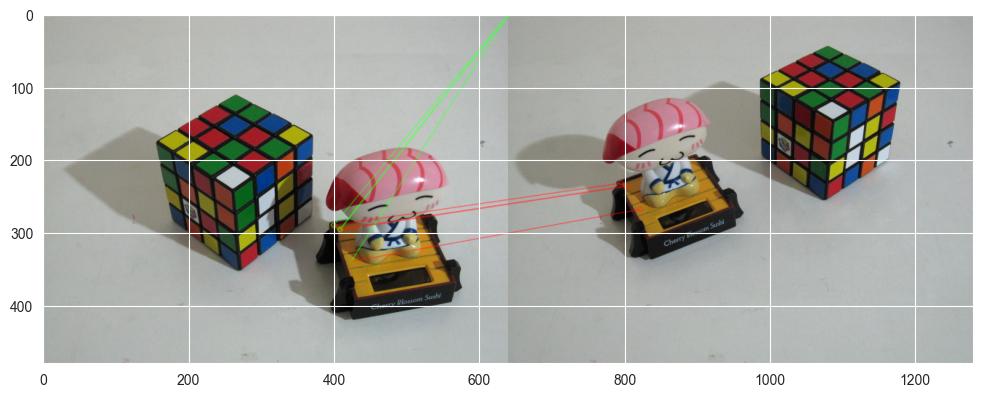

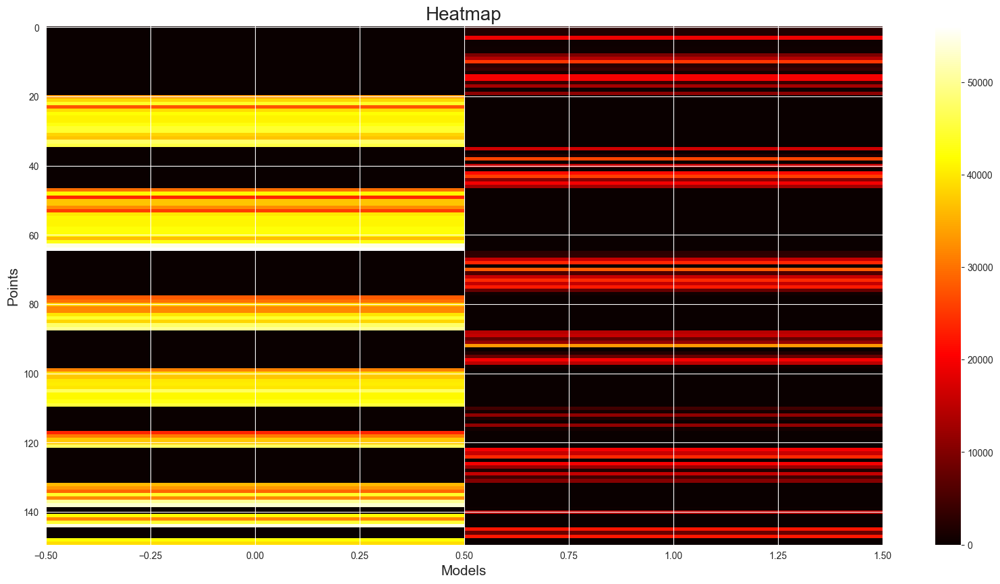

60.0 inliers found
the total number of point is:  63
The indexes of outlier points are: [0, 99, 164]


<Figure size 640x480 with 0 Axes>

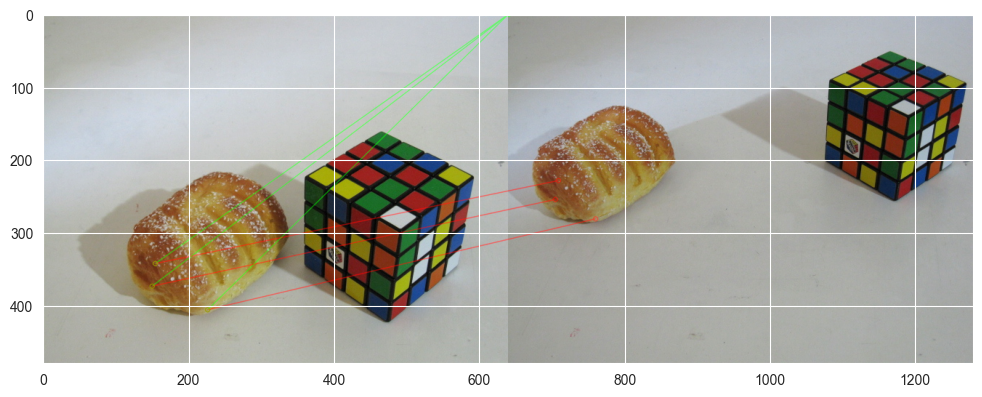

95.0 inliers found
the total number of point is:  102
The indexes of outlier points are: [87, 115, 127, 146, 158, 159, 163]


<Figure size 640x480 with 0 Axes>

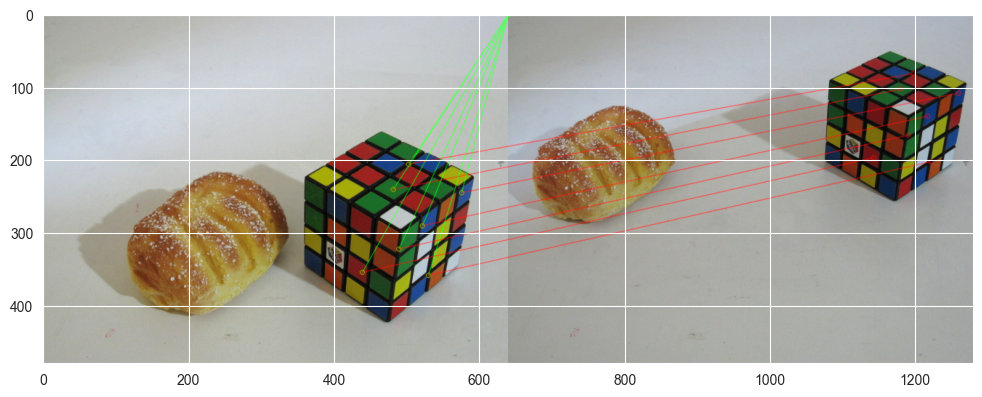

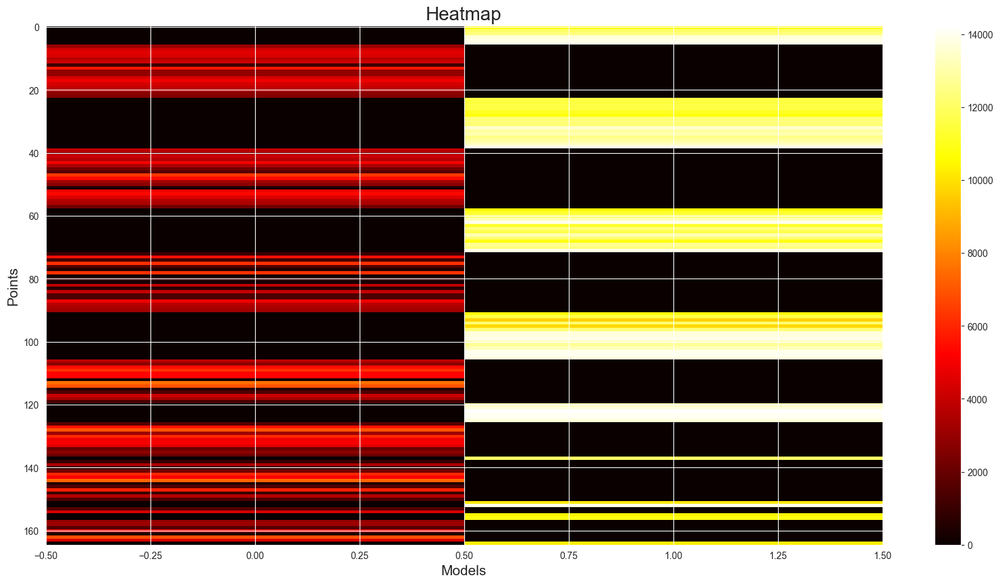

97.0 inliers found
the total number of point is:  124
The indexes of outlier points are: [0, 2, 10, 11, 18, 23, 39, 40, 61, 62, 63, 64, 75, 100, 101, 102, 104, 105, 106, 108, 110, 133, 151, 152, 156, 162, 165]


<Figure size 640x480 with 0 Axes>

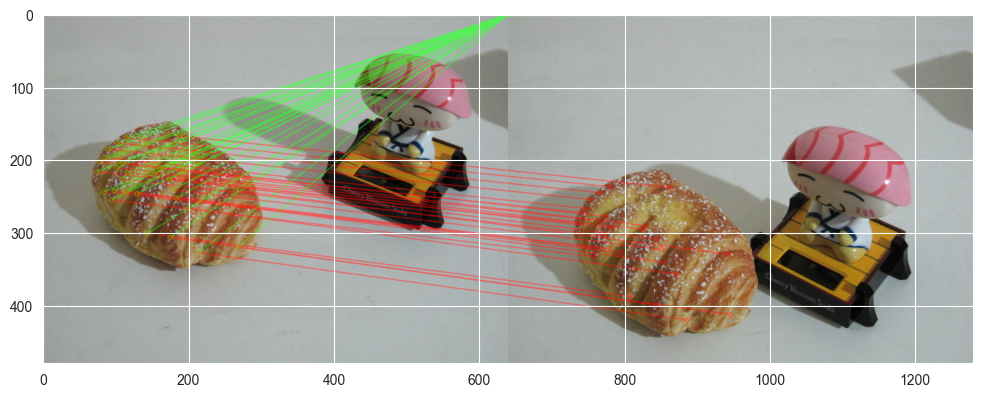

58.0 inliers found
the total number of point is:  58
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

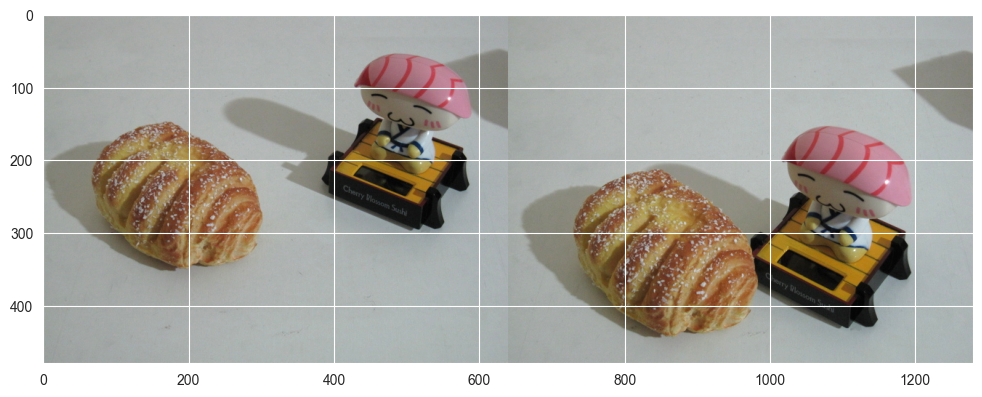

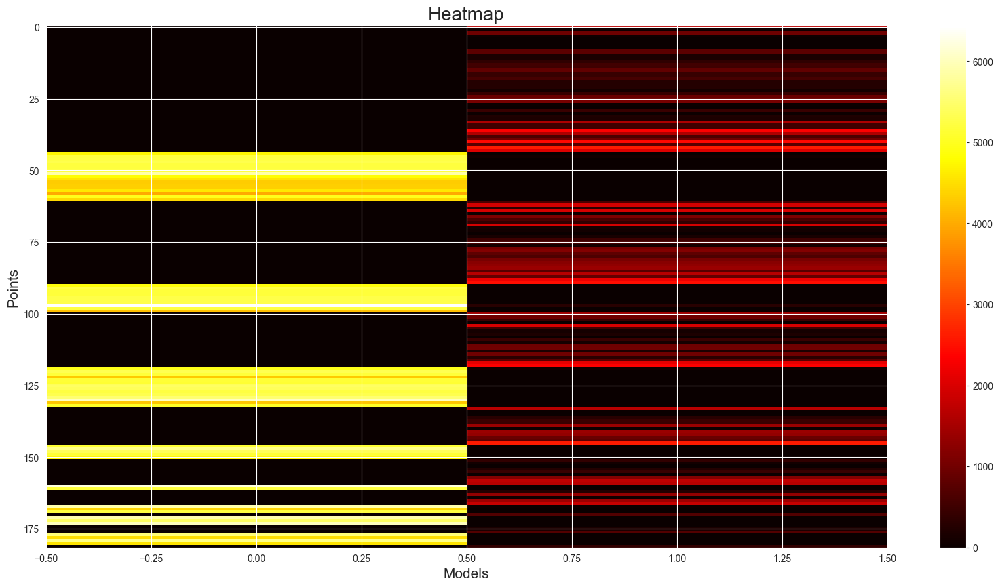

In [ ]:
plot_heat=True

for i in range(len(names)):
    data=mat_data[names[i]]
    res=build_residual_matrix(data, plot=True, method='ransac', type='FM', threshold=thresholds[i])

    if plot_heat:
        plt.figure(figsize=(20, 10))  # Adjust figure size here
        plt.imshow(res, cmap='hot', interpolation='nearest', aspect="auto")
        #cbar = plt.colorbar()  # Add colorbar to show values
        plt.colorbar().ax.tick_params(labelsize=10)  # Adjust colorbar label size
        plt.title('Heatmap', fontsize=20)  # Adjust title font size
        plt.xlabel('Models', fontsize=15)  # Adjust x-axis label font size
        plt.ylabel('Points', fontsize=15)  # Adjust y-axis label font size
        plt.show()